<center>

--- 

# Práctica Métodos Generativos
## Eliminacion de marcas de agua con GAN basada en U-Net
### Pablo Ariño, Che Cui, Jorge De la Rosa, Álvaro Laguna
### Grado en Ciencia de Datos e Inteligencia Artificial
<img src=https://www.upm.es/sfs/Rectorado/Gabinete%20del%20Rector/Logos/UPM/Logotipo%20con%20Leyenda/LOGOTIPO%20leyenda%20color%20PNG.png width=25% height=25%>

---
</center>

TODO: Resumen del Notebook

Índice:
- [Configuración y librerías](##-Configuración-y-librerías)
- [Carga y procesado de los datos](##-Carga-y-procesado-de-los-datos)
- [Pre-entrenamientos](##-Pre-entrenamientos)
  - [Autoencoder I: sin marca de agua a sin marca de agua](###-Autoencoder-I:-sin-marca-de-agua-a-sin-marca-de-agua)
  - [Autoencoder II: con marca de agua a con marca de agua](###-Autoencoder-II:-con-marca-de-agua-a-con-marca-de-agua)
  - [U-Net: Inpainting de imágenes sin marca de agua](###-U-Net:-Inpainting-de-imágenes-sin-marca-de-agua)
  - [Discriminador: Clasificación de imágenes con y sin marca de agua](###-Discriminador:-Clasificación-de-imágenes-con-y-sin-marca-de-agua)
- [Entrenamientos](##-Entrenamientos)
  - [GAN](###-GAN)
    - [Entrenamiento 1: Autoencoder I + Discriminador](####-Entrenamiento-1:-Autoencoder-I-+-Discriminador)
    - [Entrenamiento 2: Autoencoder II + Discriminador](####-Entrenamiento-2:-Autoencoder-II-+-Discriminador)
    - [Entrenamiento 3: U-Net + Discriminador](####-Entrenamiento-3:-U-Net-+-Discriminador)
  - [Función de recompensa](###-Función-de-recompensa)
    - [Entrenamiento 4: Autoencoder I + Discriminador pre-entrenado](####-Entrenamiento-4:-Autoencoder-I-+-Discriminador-pre-entrenado)
    - [Entrenamiento 5: Autoencoder II + Discriminador pre-entrenado](####-Entrenamiento-5:-Autoencoder-II-+-Discriminador-pre-entrenado)
    - [Entrenamiento 6: U-Net + Discriminador pre-entrenado](####-Entrenamiento-6:-U-Net-+-Discriminador-pre-entrenado)


## Configuración y librerías

In [1]:
import yaml
import cv2
import matplotlib.pyplot as plt
import random
import numpy as np
import os
from keras.models import load_model, Model
from keras.layers import Input

# Our functions:
from water_mark_remover import (
    load_and_prepare_data,
    build_generator,
    build_discriminator,
    get_optimizer,
    build_combined,
    construct_dataset
)

2023-12-17 18:37:49.221824: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-17 18:37:49.239862: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-17 18:37:49.239889: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-17 18:37:49.239901: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-17 18:37:49.244060: I tensorflow/core/platform/cpu_feature_g

In [2]:
CONFIG_PATH = "config/"
CONFIG_FILE_NAME = "entrega_config.yml"

# Read config file
with open(CONFIG_PATH + CONFIG_FILE_NAME, 'r') as f:
    config = yaml.safe_load(f)
config

{'load_and_prepare_data': {'train_wm_path': 'wm-nowm/train/watermark/',
  'train_nwm_path': 'wm-nowm/train/no-watermark/',
  'valid_wm_path': 'wm-nowm/valid/watermark/',
  'valid_nwm_path': 'wm-nowm/valid/no-watermark/',
  'train_size': 0.8,
  'width': 128,
  'height': 128},
 'build_discriminator': {'input_shape': [128, 128, 3],
  'filters': [20, 40, 80, 80],
  'kernel_size': 3,
  'strides': [2, 2, 2, 2],
  'activation': 'leaky_relu',
  'alpha': 0.2,
  'dropout_rate': 0.4,
  'use_batch_norm': False,
  'dense_units': 512},
 'generator': {'filter_sizes': [32, 64, 128]},
 'training': {'epochs': 200}}

## Carga y procesado de los datos

La función `load_and_prepare_data` se encarga de cargar los datos de entrenamiento, validación y test, y de prepararlos para su uso en los modelos. En concreto, se encarga de:
- Leer y emparejar los nombres de los archivos de datos de entrenamiento y validación, tanto para imágenes con marca de agua como sin ella.
- Cargar y redimensionar estas imágenes al tamaño deseado.
- Aplicar técnicas de aumento de datos (data augmentation) a las imágenes de entrenamiento para mejorar la generalización del modelo mediante cambios de contraste y brillo.
- Normalizar los valores de los píxeles de las imágenes para que estén en el rango de 0 a 1.

El código ha sido refactorizado y adaptado de [este Notebook de kaggle](https://www.kaggle.com/code/therealcyberlord/watermark-removal-using-convolutional-autoencoder). Es por eso que el archivo en cuál se encuentra esta función se llama [kaggle_utils.py](water_mark_remover/kaggle_utils.py).


In [3]:
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
    **config["load_and_prepare_data"]
)

2023-12-17 18:38:24.486004: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-12-17 18:38:24.499471: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-12-17 18:38:24.499501: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-12-17 18:38:24.500884: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:880] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-12-17 18:38:24.500905: I tensorflow/compile

In [4]:
X_train.shape

(2788, 128, 128, 3)

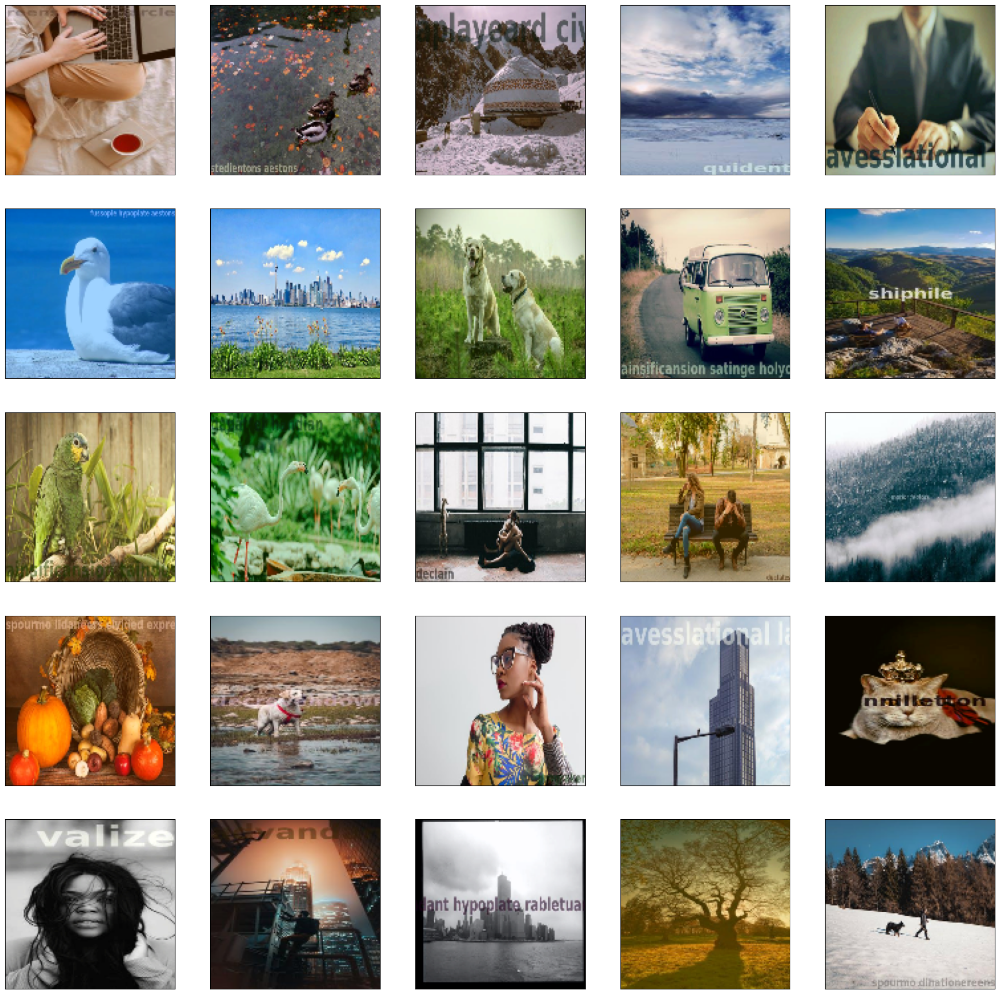

In [5]:
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i + 1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    image = X_train[random.randint(1, len(X_train))]

    # Normalize and convert to 8-bit format if necessary
    if image.dtype != np.uint8:
        image = (image - image.min()) / (
            image.max() - image.min()
        )
        image = (image * 255).astype(np.uint8)

    plt.imshow(
        cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    )  # not using cv2 as it messed up the code
plt.show()

## Pre-entrenamientos

### Autoencoder I: sin marca de agua a sin marca de agua

In [6]:
height, width, channels = X_train[0].shape
unet_ssc_sin2sin = build_generator(
    height,
    width, 
    config["generator"]["filter_sizes"],
    use_batch_norm=False,
    use_skip_connections=False
)

unet_ssc_sin2sin.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 128, 128, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      9248      
                                                                 
 max_pooling2d (MaxPooling2  (None, 64, 64, 32)        0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 64, 64, 64)        36928     
                                                             

In [7]:
unet_ssc_sin2sin.compile(
    loss="mse",
    optimizer="adam",
    metrics=["mae"],
)

In [ ]:
history = unet_ssc_sin2sin.fit(
    y_train, 
    y_train, 
    epochs=200,
    batch_size=128,
    validation_data=(y_val, y_val)
)

#### Resultados

 7/11 [==================>...........] - ETA: 0s

2023-12-17 13:31:13.898457: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


11/11 [==============================] - 1s 21ms/step


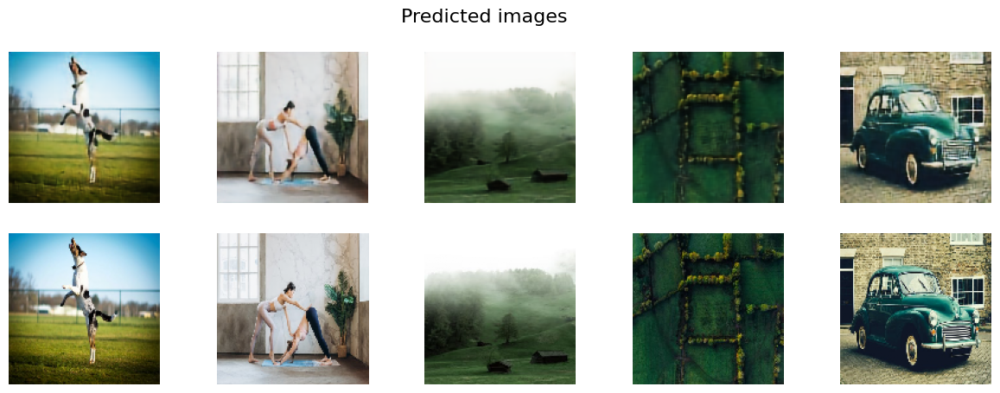

In [10]:
# show predict images
y_pred = unet_ssc_sin2sin.predict(y_test)

plt.rcParams["figure.figsize"] = [15, 5]
fig, axs = plt.subplots(2, 5)
fig.suptitle("Predicted images", fontsize=16)
for i in range(5):
    axs[0, i].imshow(y_pred[i][:, :, ::-1])
    axs[0, i].axis("off")

for i in range(5):
    axs[1, i].imshow(y_test[i][:, :, ::-1])
    axs[1, i].axis("off")
plt.show()
plt.close()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


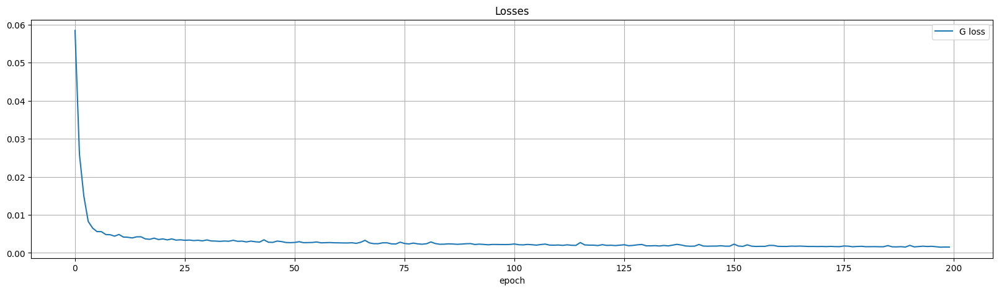

In [ ]:
# plot  val losses with plt
plt.rcParams['figure.figsize'] = [20, 5]
# Create a single subplot
fig, ax1 = plt.subplots()


ax1.set_title('Losses')
ax1.set_xlabel('epoch')
ax1.legend(loc="upper right")
ax1.grid()


ax1.plot(history.history['loss'], label='G loss')
ax1.legend()



plt.show()


### Autoencoder II: con marca de agua a con marca de agua

In [ ]:
unet_ssc_con2con = build_generator(
    height,
    width,
    config["generator"]["filter_sizes"],
    use_batch_norm=False,
    use_skip_connections=False,
)
unet_ssc_con2con.summary()

In [ ]:
unet_ssc_con2con.compile(
    loss="mse",
    optimizer="adam",
    metrics=["mae"],
)

In [ ]:
history = unet_ssc_con2con.fit(
    X_train, 
    X_train, 
    epochs=200,
    batch_size=128,
    validation_data=(X_val, X_val)
)

#### Resultados

11/11 [==============================] - 1s 46ms/step


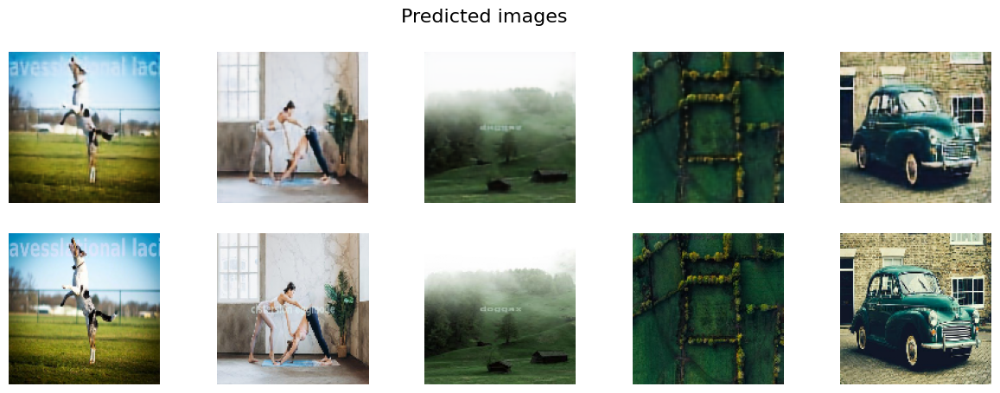

In [ ]:
# show predict images
y_pred = unet_ssc_con2con.predict(X_test)

plt.rcParams['figure.figsize'] = [15, 5]
fig, axs = plt.subplots(2, 5)
fig.suptitle('Predicted images', fontsize=16)
for i in range(5):
    axs[0,i].imshow(y_pred[i][:,:,::-1])
    axs[0,i].axis('off')
 
for i in range(5):
    axs[1,i].imshow(X_test[i][:,:,::-1])
    axs[1,i].axis('off')
plt.show()
plt.close()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


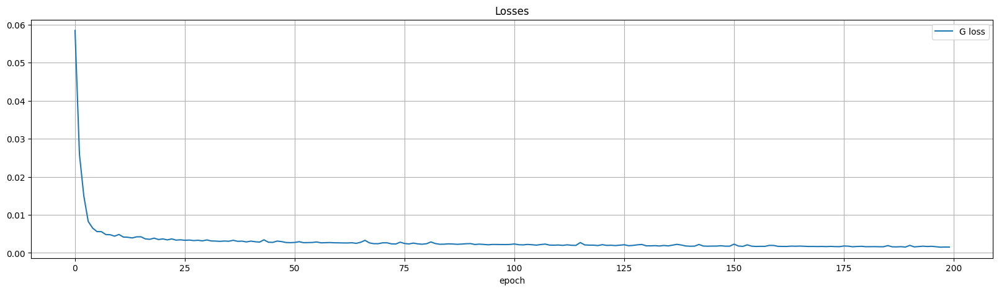

In [ ]:
# plot  val losses with plt
plt.rcParams['figure.figsize'] = [20, 5]
# Create a single subplot
fig, ax1 = plt.subplots()


ax1.set_title('Losses')
ax1.set_xlabel('epoch')
ax1.legend(loc="upper right")
ax1.grid()


ax1.plot(history.history['loss'], label='G loss')
ax1.legend()



plt.show()


### U-Net: Inpainting de imágenes sin marca de agua

#### Creamos imágenes con parches

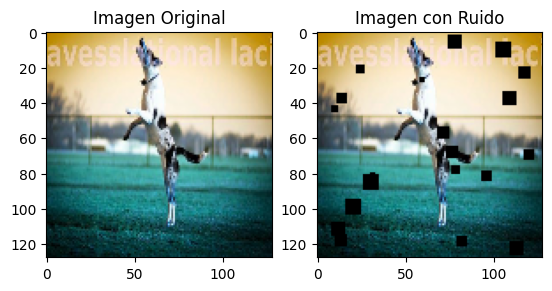

In [ ]:
# Función para añadir parches de ruido a la imagen
def agregar_parches_de_ruido(imagen, cantidad_parches=100, tamaño_max=20):
    imagen_con_ruido = np.copy(imagen)
    
    alto, ancho, _ = imagen.shape
    
    for _ in range(cantidad_parches):
        # Generar coordenadas aleatorias para el parche
                
        tamaño_parche = np.random.randint(3, tamaño_max)
        y = np.random.randint(0, alto - tamaño_parche)
        x = np.random.randint(0, ancho - tamaño_parche)

        
        # Superponer el parche de ruido en la imagen
        imagen_con_ruido[y:y+tamaño_parche, x:x+tamaño_parche, :] = 0
        
        
        # Asegurarse de que los valores estén en el rango [0, 255]
        imagen_con_ruido = np.clip(imagen_con_ruido, 0, 255)
    
    return imagen_con_ruido

# Añadir parches de ruido a la imagen
imagen_con_ruido = agregar_parches_de_ruido(X_test[0], cantidad_parches=20, tamaño_max=10)

# Mostrar la imagen original y la imagen con ruido
plt.subplot(1, 2, 1)
plt.imshow(X_test[0])
plt.title('Imagen Original')

plt.subplot(1, 2, 2)
plt.imshow(imagen_con_ruido)
plt.title('Imagen con Ruido')

plt.show()

In [ ]:
# transformamos train and test images en imagenes con ruido
X_train_noise = []
X_test_noise = []

for image in y_train:
    X_train_noise.append(
        agregar_parches_de_ruido(image, cantidad_parches=20, tamaño_max=10)
    )

for image in y_test:
    X_test_noise.append(
        agregar_parches_de_ruido(image, cantidad_parches=20, tamaño_max=10)
    )

y_train_noise = np.array(X_train_noise)
y_test_noise = np.array(X_test_noise)

#### Guardamos las imágenes con parches

In [ ]:
# create directories to save images
os.mkdir("wm-nowm/train/pretrained")
os.mkdir("wm-nowm/train/pretrained/noisy")
os.mkdir("wm-nowm/valid/pretrained")
os.mkdir("wm-nowm/valid/pretrained/noisy")

# save the noisy images
for i in range(len(y_train_noise)):
    cv2.imwrite(
        "wm-nowm/train/pretrained/noisy/" + str(i) + ".jpg", y_train_noise[i] * 255
    )

for i in range(len(y_test_noise)):
    cv2.imwrite(
        "wm-nowm/valid/pretrained/noisy/" + str(i) + ".jpg", y_test_noise[i] * 255
    )

In [ ]:
# create directories to save images
os.mkdir("wm-nowm/train/pretrained/non-noisy")
os.mkdir("wm-nowm/valid/pretrained/non-noisy")

# save the noisy images
for i in range(len(y_train)):
    cv2.imwrite(
        "wm-nowm/train/pretrained/non-noisy/" + str(i) + ".jpg", y_train[i] * 255
    )

for i in range(len(y_test)):
    cv2.imwrite(
        "wm-nowm/valid/pretrained/non-noisy/" + str(i) + ".jpg", y_test[i] * 255
    )

#### Entrenamiento

In [ ]:
# load the test and train images
train_wm_path = "wm-nowm/train/pretrained/noisy/"
train_nwm_path = "wm-nowm/train/pretrained/non-noisy/"
valid_wm_path = "wm-nowm/valid/pretrained/noisy/"
valid_nwm_path = "wm-nowm/valid/pretrained/non-noisy/"
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
    train_wm_path,
    train_nwm_path,
    valid_wm_path,
    valid_nwm_path,
    train_size=0.8,
    width=128,
    height=128,
    data_augmentation=False,
)

In [ ]:
# UNet CSC inpaint
unet_csc_inpaint = build_generator(
    height,
    width,
    config["generator"]["filter_sizes"],
    use_batch_norm=False,
    use_skip_connections=True,
)
unet_csc_inpaint.summary()

In [ ]:
unet_csc_inpaint.compile(optimizer="adam", loss="mse", metrics=["mae"])

In [ ]:
unet_csc_inpaint.fit(
    X_train,
    y_train,
    epochs=200,
    batch_size=128,
    validation_data=(X_val, y_val),
)

#### Resultados

18/18 [==============================] - 1s 18ms/step


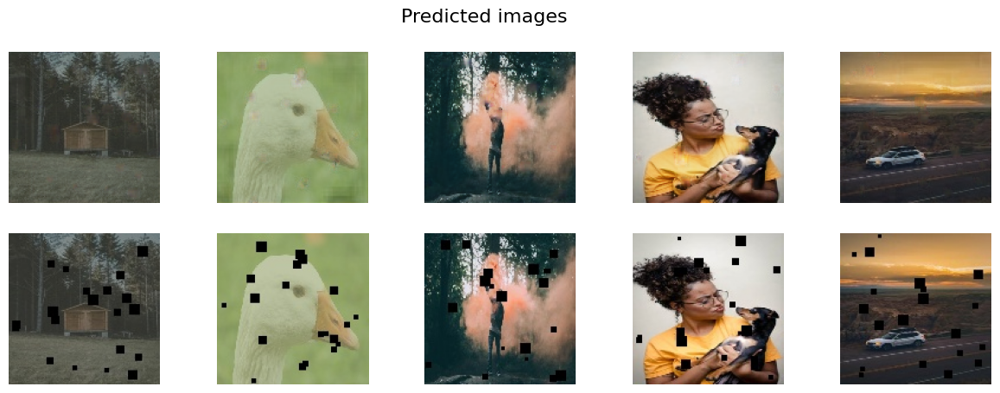

In [ ]:
# show predict images
y_pred = unet_csc_inpaint.predict(X_test)
 
plt.rcParams['figure.figsize'] = [15, 5]
fig, axs = plt.subplots(2, 5)
fig.suptitle('Predicted images', fontsize=16)
for i in range(5):
    axs[0,i].imshow(y_pred[i][:,:,::-1])
    axs[0,i].axis('off')

for i in range(5):
    axs[1,i].imshow(X_test[i][:,:,::-1])
    axs[1,i].axis('off')
plt.show()
plt.close()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


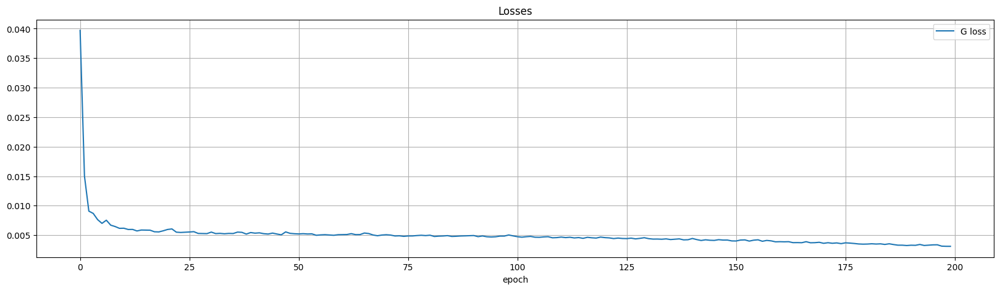

In [ ]:
# plot  val losses with plt
plt.rcParams['figure.figsize'] = [20, 5]
# Create a single subplot
fig, ax1 = plt.subplots()


ax1.set_title('Losses')
ax1.set_xlabel('epoch')
ax1.legend(loc="upper right")
ax1.grid()


ax1.plot(history.history['loss'], label='G loss')
ax1.legend()

plt.show()


### Discriminador: Clasificación de imágenes con y sin marca de agua

In [4]:
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
        **config["load_and_prepare_data"]
    )
X_train, y_train = construct_dataset(X_train, y_train)
X_val, y_val = construct_dataset(X_val, y_val)
X_test, y_test = construct_dataset(X_test, y_test)

In [5]:
discriminator = build_discriminator(**config["build_discriminator"])
optimizer = get_optimizer(name="adam", learning_rate=0.0008777)
discriminator.compile(
    optimizer=optimizer, loss="binary_crossentropy", metrics=["accuracy"]
)

In [6]:
discriminator.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 64, 64, 20)        560       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 20)        0         
                                                                 
 dropout (Dropout)           (None, 64, 64, 20)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 32, 32, 40)        7240      
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 40)        0         
                                                                 
 dropout_1 (Dropout)         (None, 32, 32, 40)        0     

In [7]:
# Train the discriminator
history = discriminator.fit(
    X_train,
    y_train,
    batch_size=32,
    validation_data=(X_val, y_val),
    epochs=50,
)

# evaluate the discriminator
_, test_acc = discriminator.evaluate(X_test, y_test, verbose=0)
print("Test Accuracy: %.3f" % (test_acc * 100))

Epoch 1/50


2023-12-17 14:52:55.730726: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-12-17 14:52:55.808026: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8902
2023-12-17 14:52:55.863211: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 14:52:56.105928: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 14:52:56.753705: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fc5b2b76ac0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-12-17 14:52:56.753734: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Cap

175/175 [==============================] - 4s 7ms/step - loss: 0.7848 - accuracy: 0.4778 - val_loss: 7.8719 - val_accuracy: 0.5000
Epoch 2/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6954 - accuracy: 0.4968 - val_loss: 17.0243 - val_accuracy: 0.5000
Epoch 3/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6950 - accuracy: 0.4984 - val_loss: 1.3443 - val_accuracy: 0.4953
Epoch 4/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6951 - accuracy: 0.4919 - val_loss: 4.3137 - val_accuracy: 0.5000
Epoch 5/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6949 - accuracy: 0.5018 - val_loss: 18.4508 - val_accuracy: 0.5000
Epoch 6/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6943 - accuracy: 0.4984 - val_loss: 2.4835 - val_accuracy: 0.5093
Epoch 7/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6952 - accuracy: 0.5034 - val_loss: 9.0793 - val_accuracy: 0.5000
Epoch 8/50
175/

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


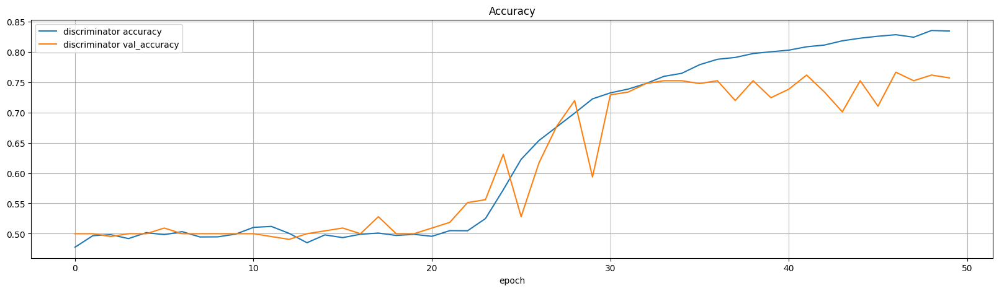

In [10]:
# plot  val losses with plt
plt.rcParams["figure.figsize"] = [20, 5]
# Create a single subplot
fig, ax1 = plt.subplots()


ax1.set_title("Accuracy")
ax1.set_xlabel("epoch")
ax1.legend(loc="upper right")
ax1.grid()


ax1.plot(history.history["accuracy"], label="discriminator accuracy")
ax1.plot(history.history["val_accuracy"], label="discriminator val_accuracy")
ax1.legend()

plt.show()

## Entrenamientos

In [4]:
MODELS_FOLDER = "models/"
UNET_SSC_SIN2SIN = MODELS_FOLDER + "modelo_NW_NW.h5"
UNET_SSC_CON2CON = MODELS_FOLDER + "modelo_WM_WM.h5"
UNET_CSC_INPAINT = MODELS_FOLDER + "modelo_WM_NW.h5"

### GAN

In [12]:
def sample_images(epoch, batch, gen_imgs, imgs):
    plt.rcParams['figure.figsize'] = [15, 5]
    fig, axs = plt.subplots(2, 5)
    fig.suptitle('Epoch: ' + str(epoch) + ', Batch: ' + str(batch), fontsize=16)
    for i in range(5):
        
        axs[0,i].imshow(gen_imgs[i][:,:,::-1])
        axs[0,i].axis('off')

    for i in range(5):
        axs[1,i].imshow(imgs[i][:,:,::-1])
        axs[1,i].axis('off')
    plt.show()
    plt.close()

In [37]:
def plot_losses(history):
    plt.rcParams['figure.figsize'] = [20, 5]
    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True)

    ax1.set_title('Losses')
    ax1.set_xlabel('epoch')
    ax1.legend(loc="upper right")
    ax1.grid()

    ax1.plot(history['d_loss'], label='D loss')
    ax1.plot(history['g_loss'], label='G loss')
    ax1.legend()

    ax2.set_title('D accuracy')
    ax2.set_xlabel('step')
    ax2.legend(loc="upper right")
    ax2.grid()

    ax2.plot(history['d_acc'], label='Accuracy')
    ax2.legend()

    plt.show()

In [35]:
def train(X_train, y_train, generator, discriminator, combined, epochs, batch_size=32, sample_interval=100):
    valid = np.ones((batch_size, 1))
    fake = np.zeros((batch_size, 1))

    history = {
        'd_loss' : [],
        'd_acc' : [],
        'g_loss' : []
    }

    for epoch in range(epochs):
        print("----EPOCH " + str(epoch) + '-----')
        for batch in range(int(len(X_train)/batch_size)):

            #  Train the Discriminator
            imgs_with_watermark = X_train[batch*batch_size : (batch+1)*batch_size]

            # El generador ahora deberá admitir el noise la mismo tiempo que los gen_labels generados aleatoriamente
            gen_imgs = generator.predict(imgs_with_watermark, verbose=0)

            imgs_without_watermark = y_train[batch*batch_size : (batch+1)*batch_size]

            # Añadir a las salidas deseadas del discriminador las etiquetas aleatorias y las obtenidas de y_train
            # discriminator.trainable = True
            d_loss_real = discriminator.train_on_batch(imgs_without_watermark, valid)
            d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # Train the Generator
            # Añadir como entrada y salida las etiquetas generadas
            # discriminator.trainable = False
            g_loss = combined.train_on_batch(imgs_with_watermark, [valid, imgs_without_watermark])

            # Save losses
            history['d_loss'].append(d_loss[0])
            history['d_acc'].append(d_loss[1])
            history['g_loss'].append(g_loss)

            # Plot the progress
            if batch % 50 == 0:
                print ("%d [D loss: %.4f,\t acc.: %.2f%%]\t[G loss: %.4f]" % (batch, d_loss[0], 100*d_loss[1], g_loss[0]))

            if batch % 500 == 0:
                sample_images(epoch, batch, gen_imgs, imgs_without_watermark)

        plot_losses(history)

#### Entrenamiento 1: Autoencoder I + Discriminador

In [21]:
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
    **config["load_and_prepare_data"]
)

In [30]:
# Load the generator model
generator = load_model(UNET_SSC_SIN2SIN)

# Build and compile the discriminator model
discriminator = build_discriminator(**config["build_discriminator"])
optimizer = get_optimizer(name="adam", learning_rate=0.0008777)
discriminator.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])

# Make the discriminator non-trainable when we are using it in the combined model
discriminator.trainable = False

# Build the combined model
combined_model = build_combined(generator, discriminator)

----EPOCH 0-----
0 [D loss: 0.6916,	 acc.: 51.56%]	[G loss: 0.0727]


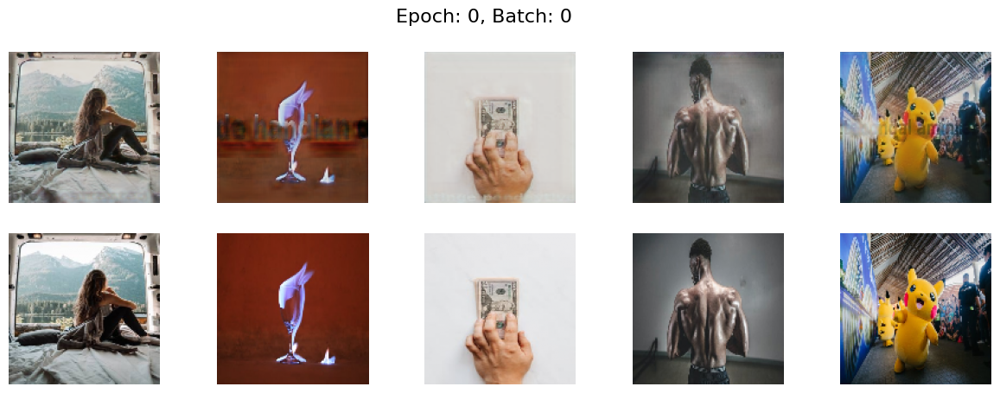

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0802]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


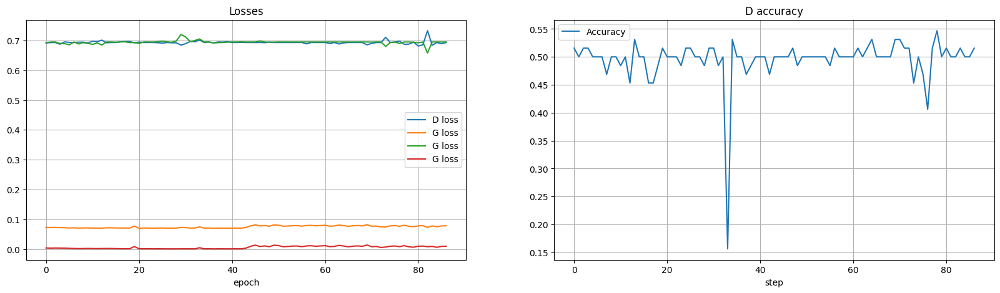

----EPOCH 1-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


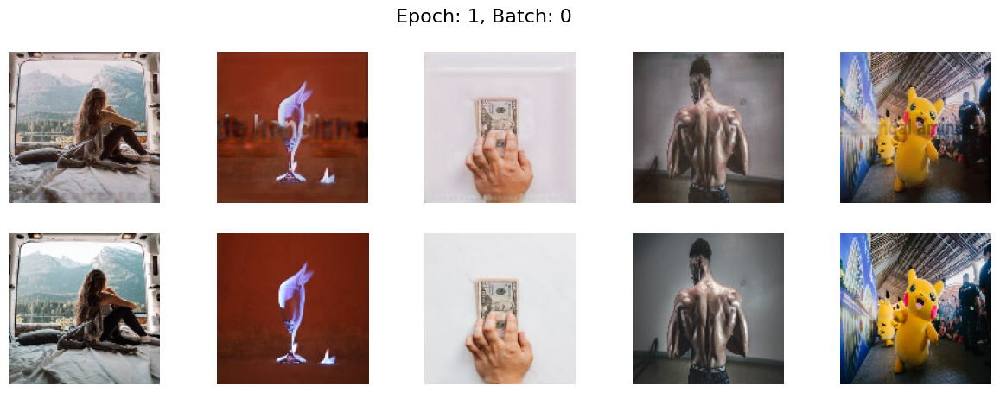

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0802]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


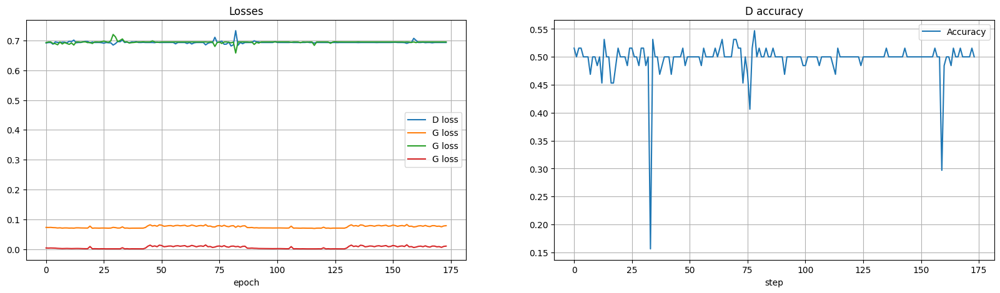

----EPOCH 2-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


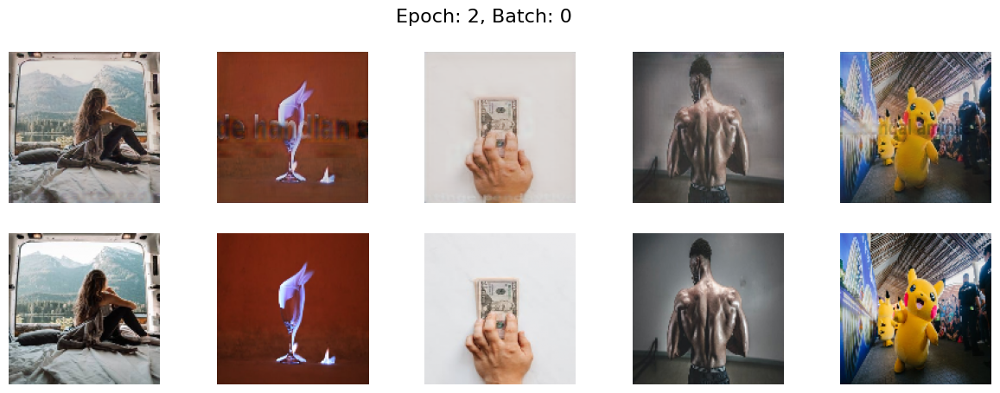

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0802]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


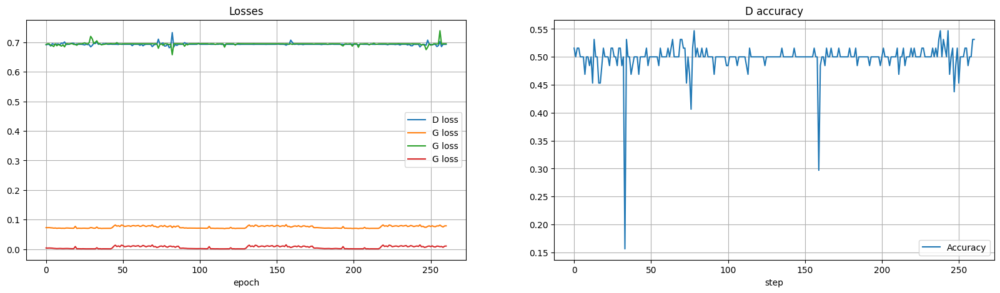

----EPOCH 3-----
0 [D loss: 0.6919,	 acc.: 48.44%]	[G loss: 0.0732]


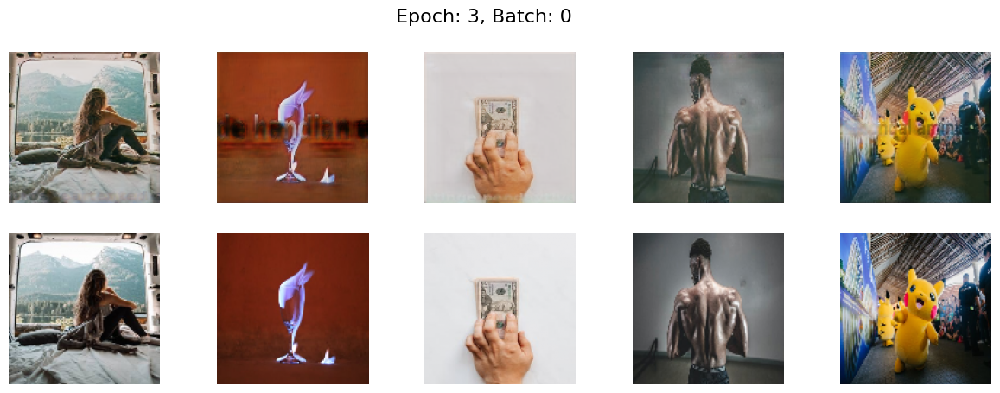

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0803]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


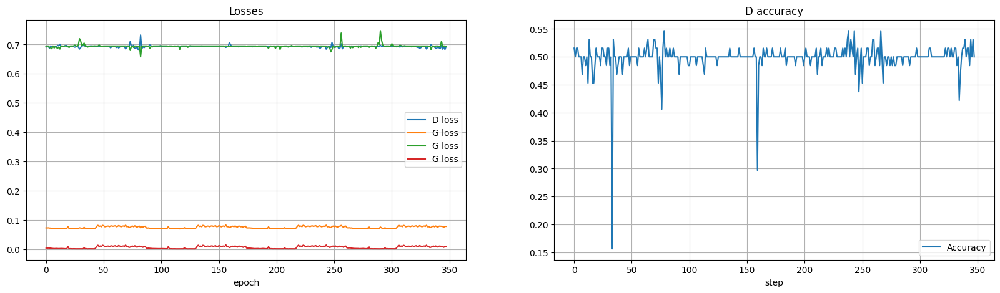

----EPOCH 4-----
0 [D loss: 0.6918,	 acc.: 51.56%]	[G loss: 0.0728]


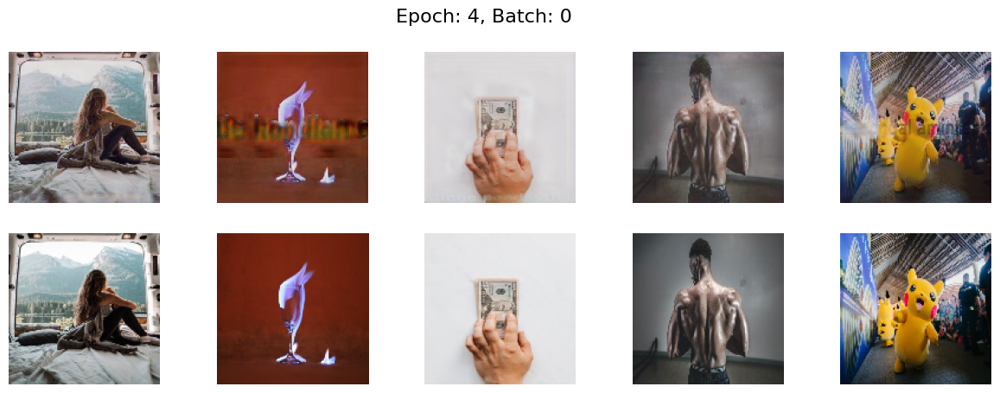

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0803]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


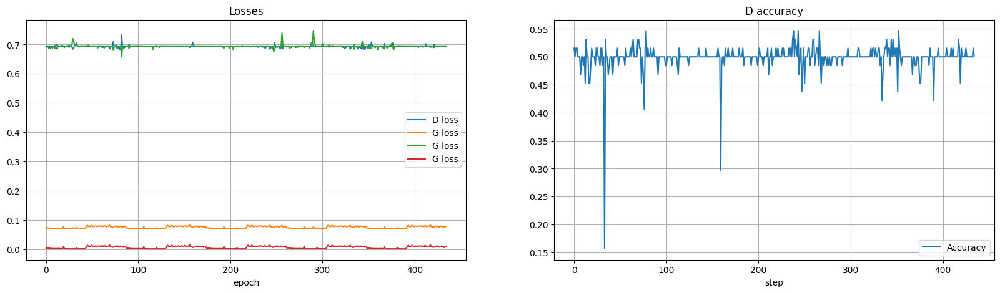

----EPOCH 5-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0725]


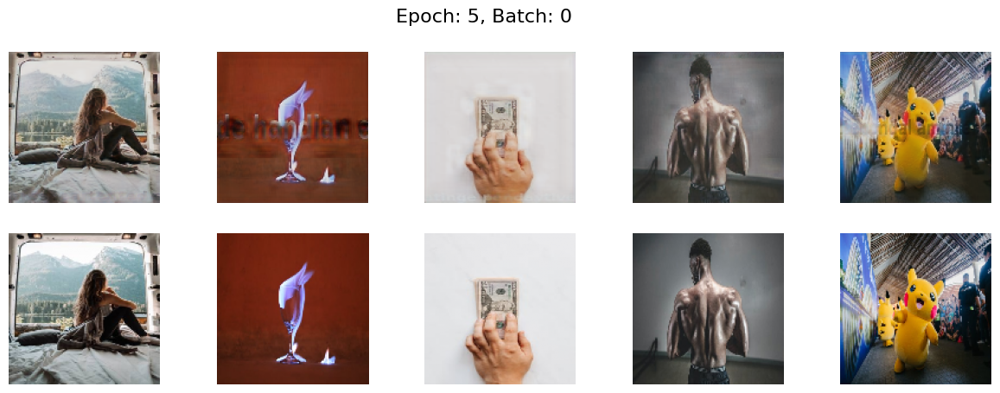

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0801]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


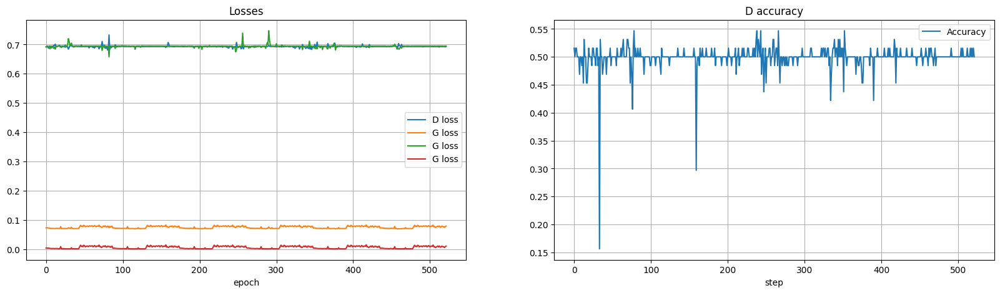

----EPOCH 6-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0728]


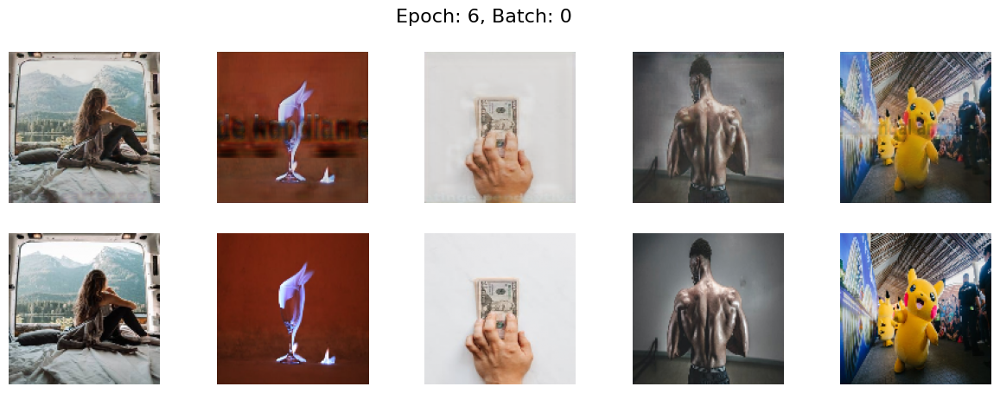

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0801]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


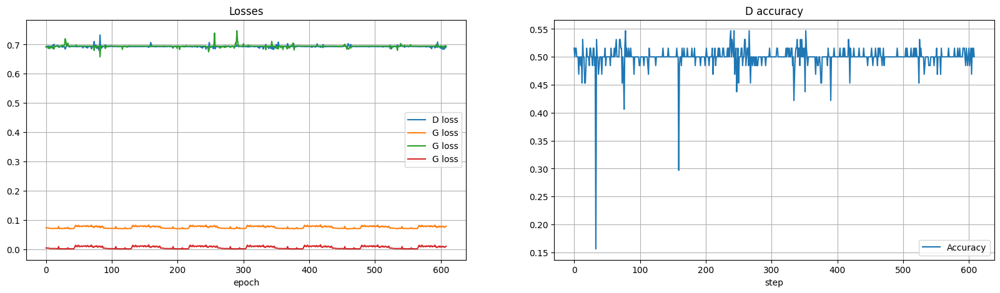

----EPOCH 7-----
0 [D loss: 0.6943,	 acc.: 50.00%]	[G loss: 0.0729]


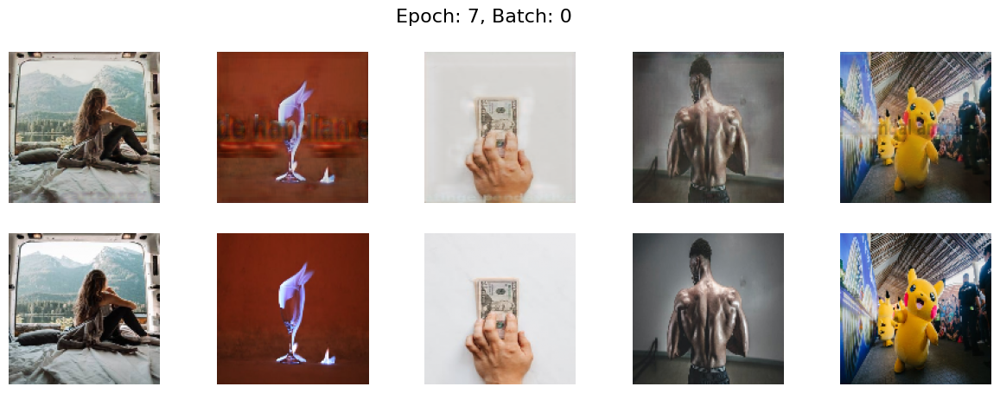

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0801]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


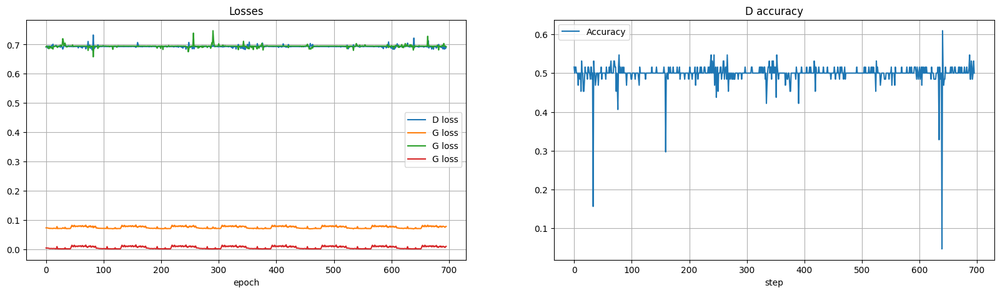

----EPOCH 8-----
0 [D loss: 0.6884,	 acc.: 53.12%]	[G loss: 0.0712]


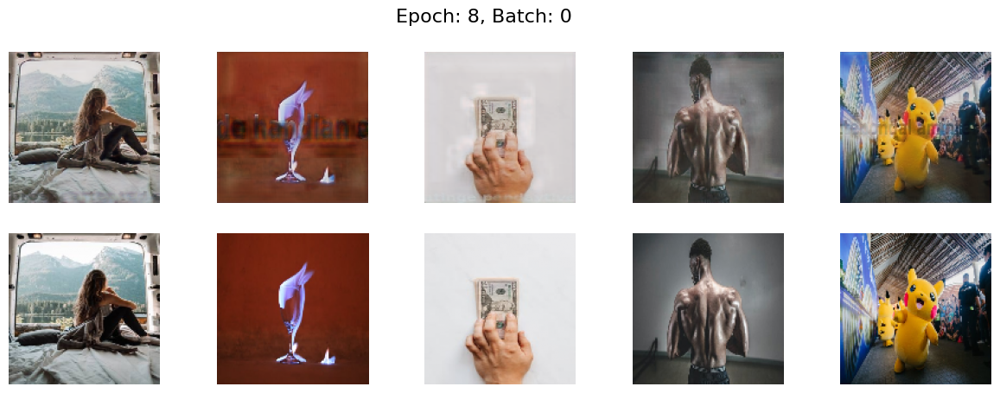

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0800]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


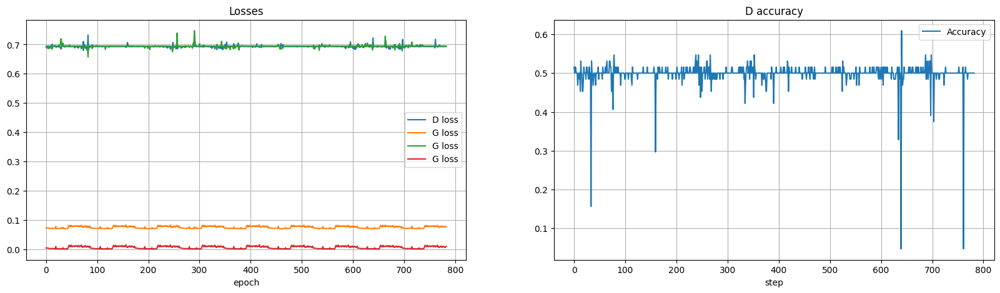

----EPOCH 9-----
0 [D loss: 0.6929,	 acc.: 51.56%]	[G loss: 0.0726]


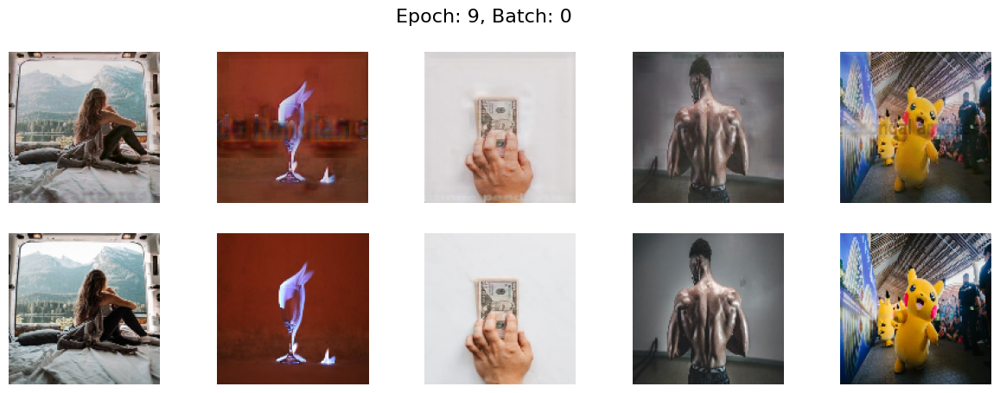

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


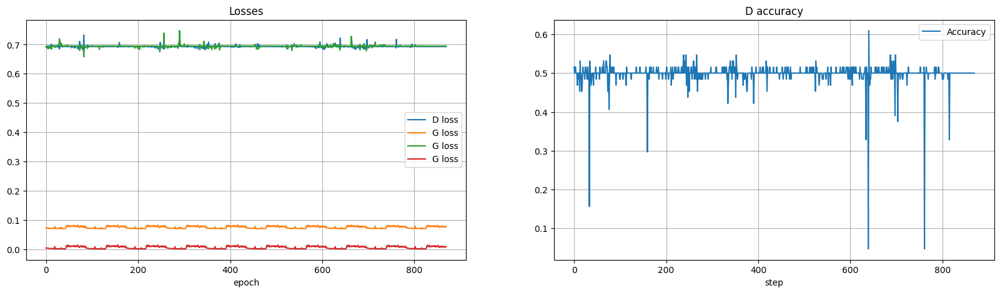

----EPOCH 10-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


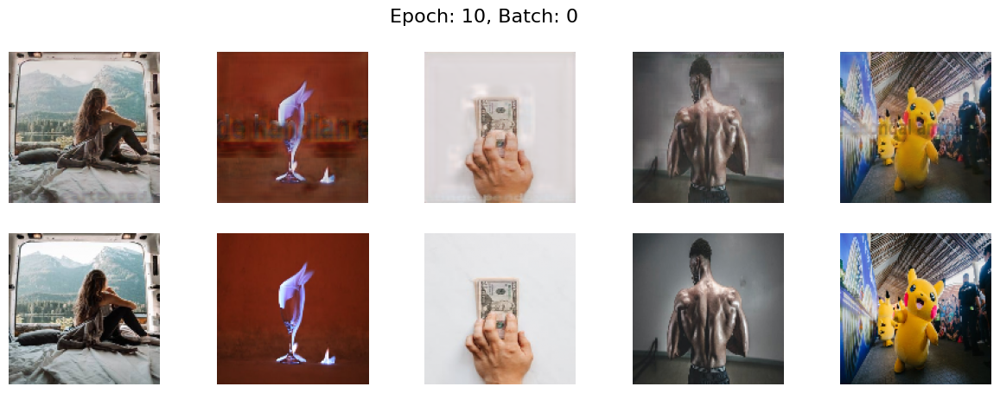

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


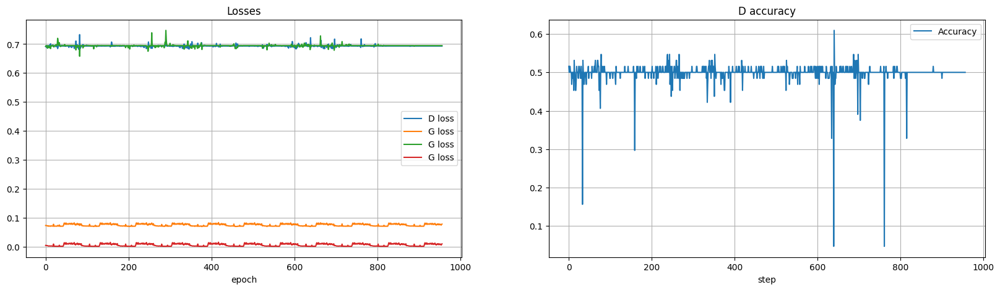

----EPOCH 11-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


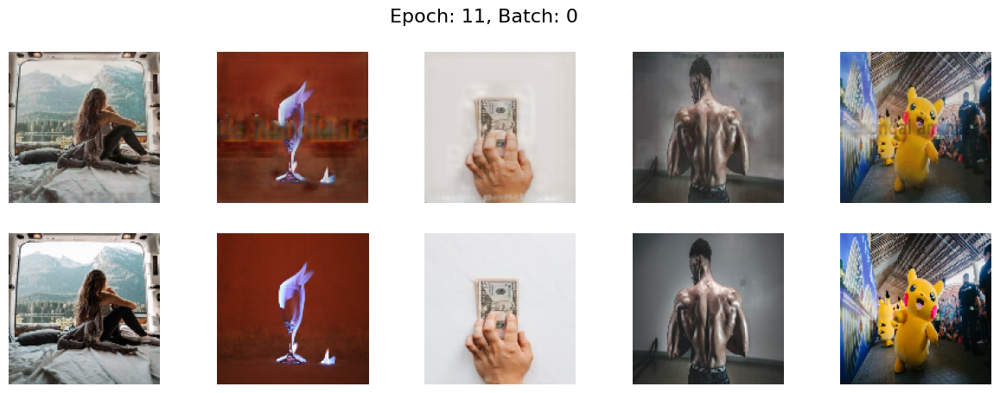

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


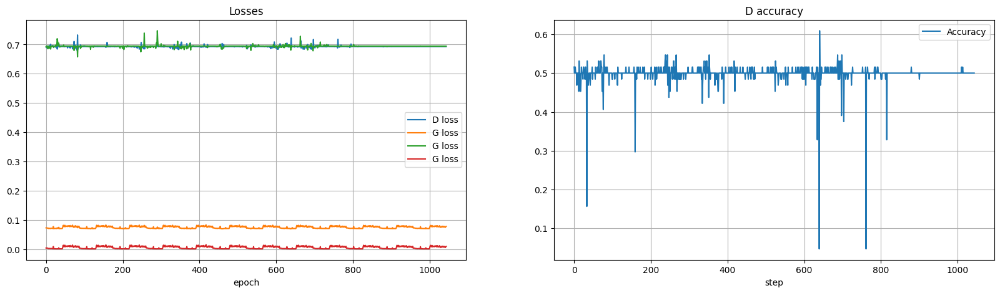

----EPOCH 12-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0728]


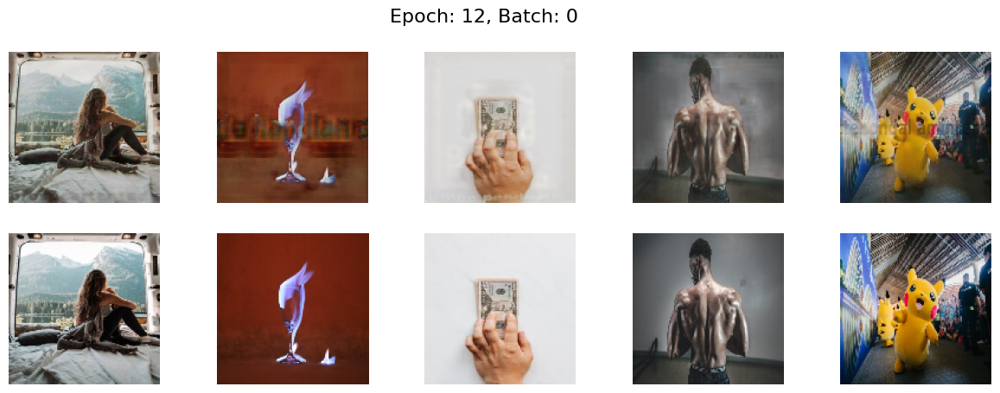

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


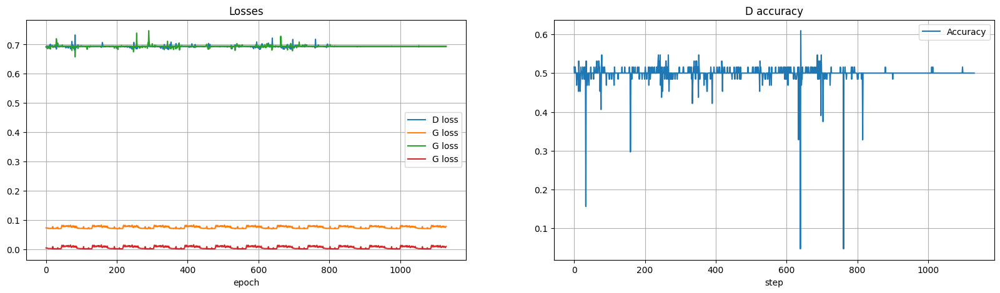

----EPOCH 13-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0729]


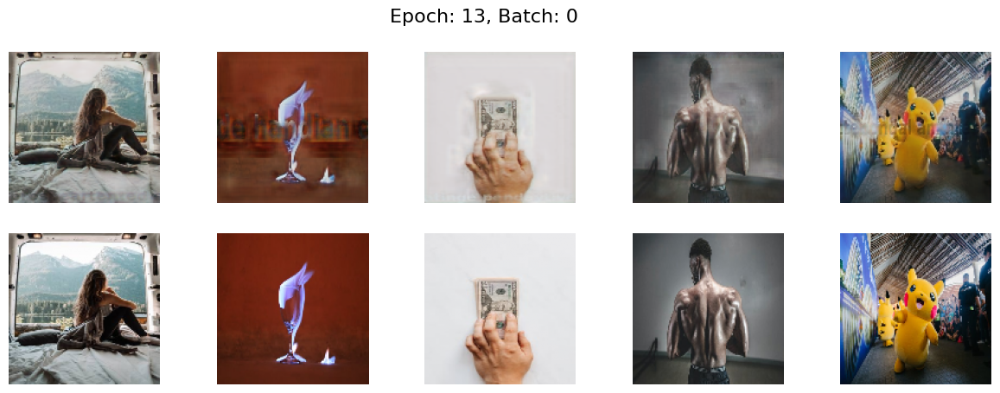

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0800]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


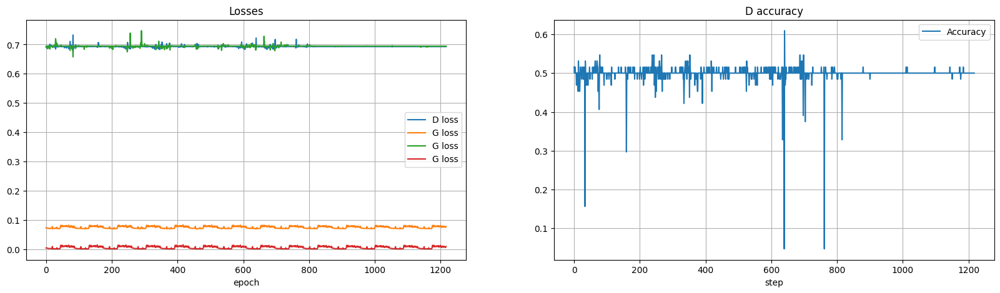

----EPOCH 14-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


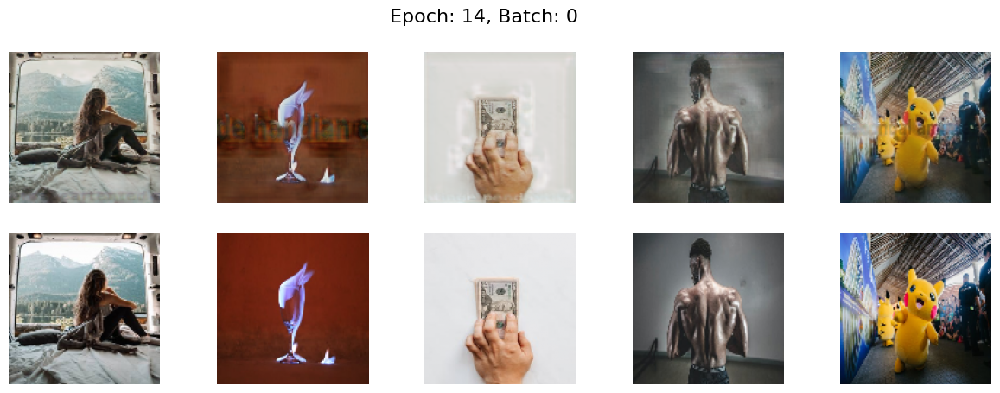

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


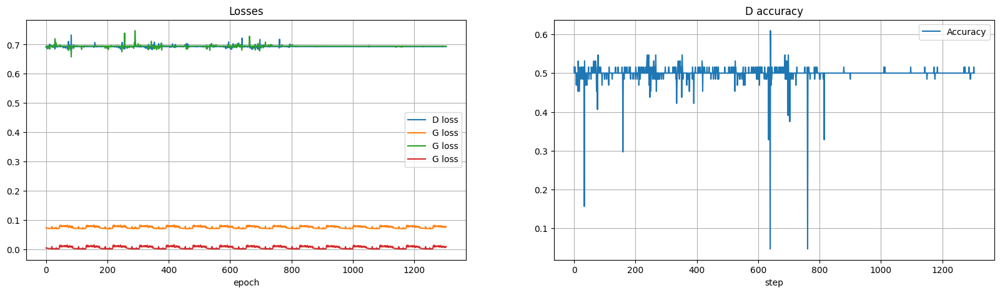

----EPOCH 15-----
0 [D loss: 0.6928,	 acc.: 51.56%]	[G loss: 0.0727]


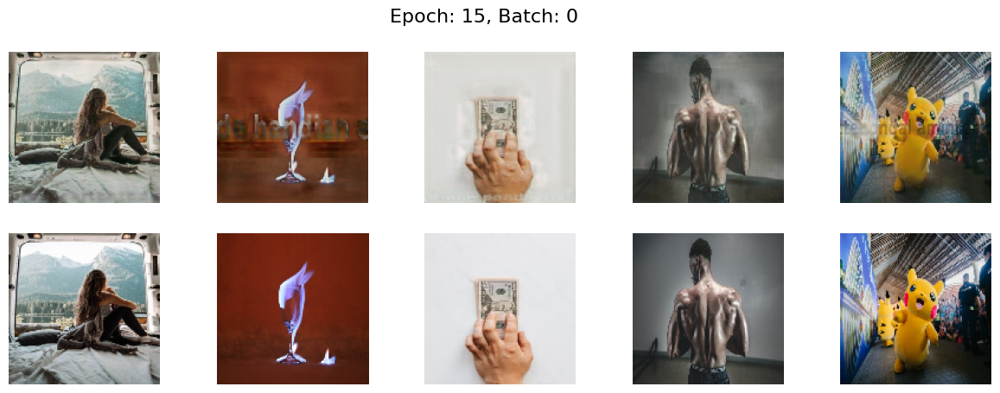

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0801]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


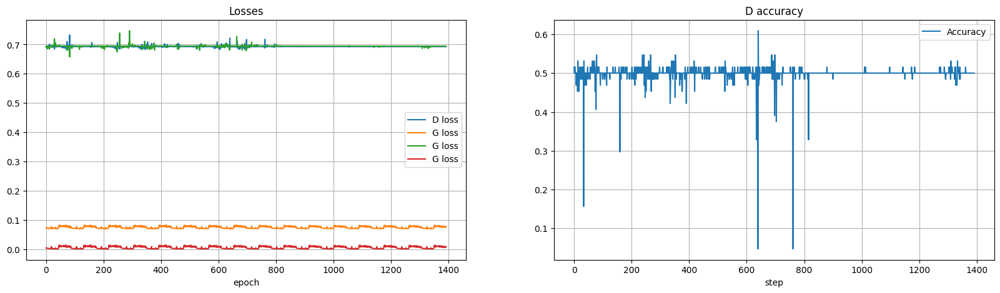

----EPOCH 16-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


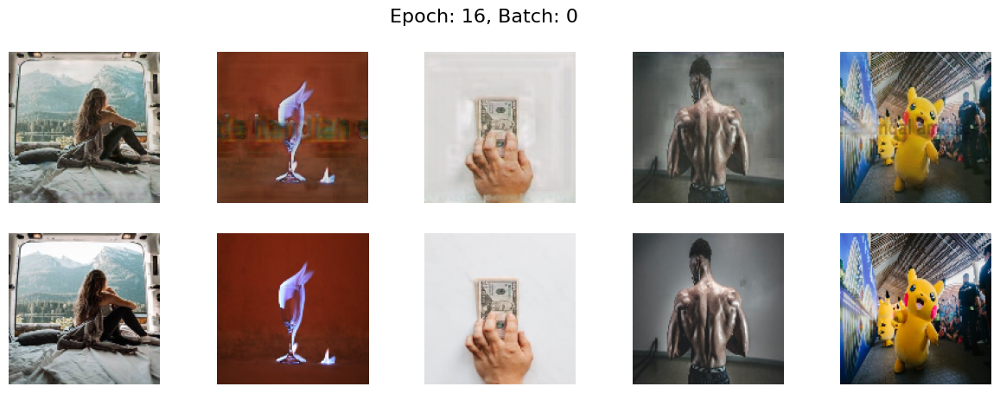

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


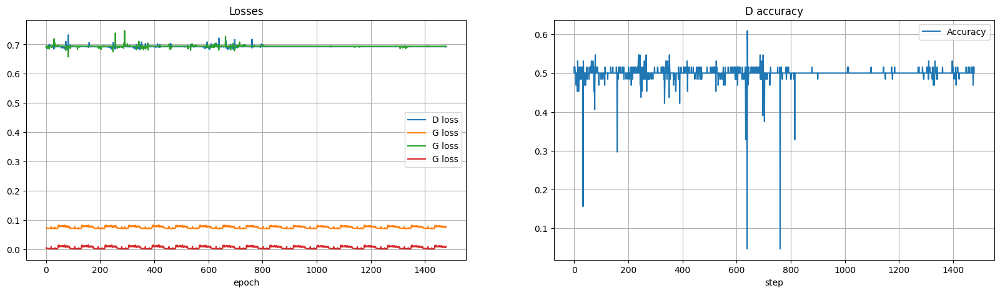

----EPOCH 17-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


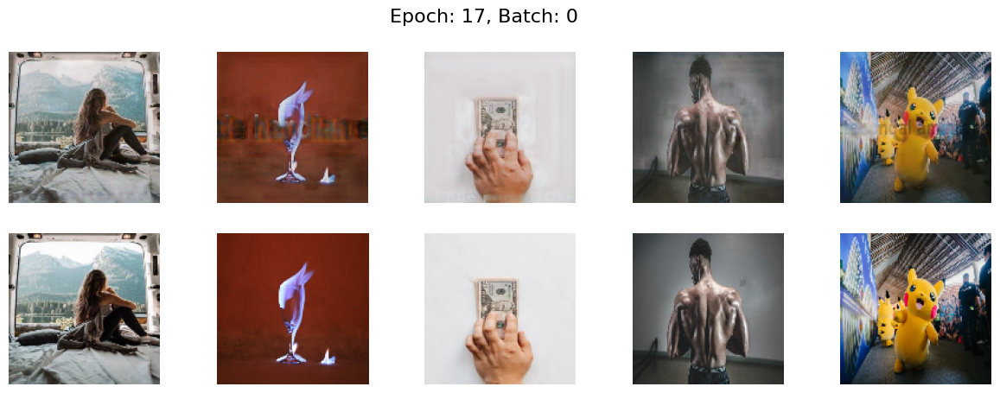

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


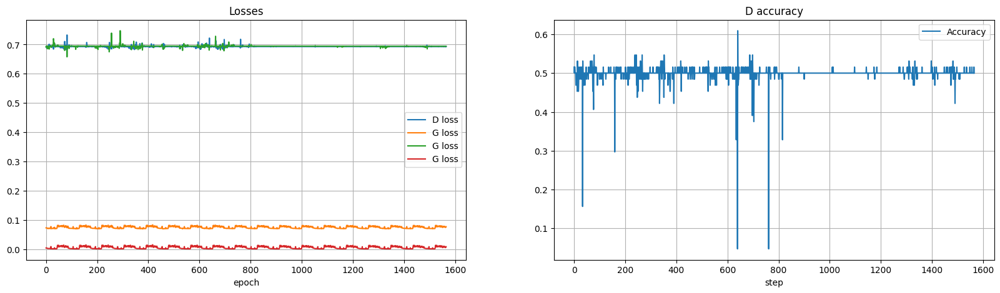

----EPOCH 18-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0722]


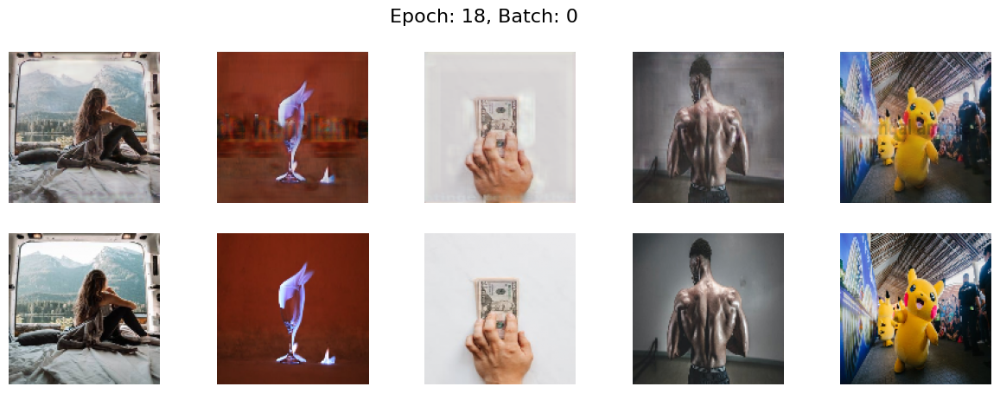

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0797]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


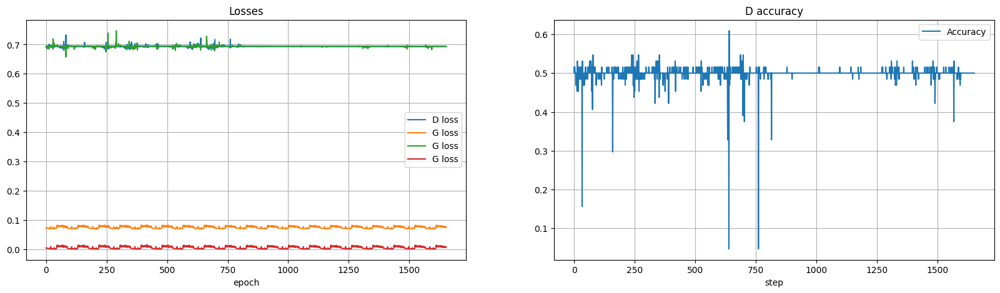

----EPOCH 19-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0723]


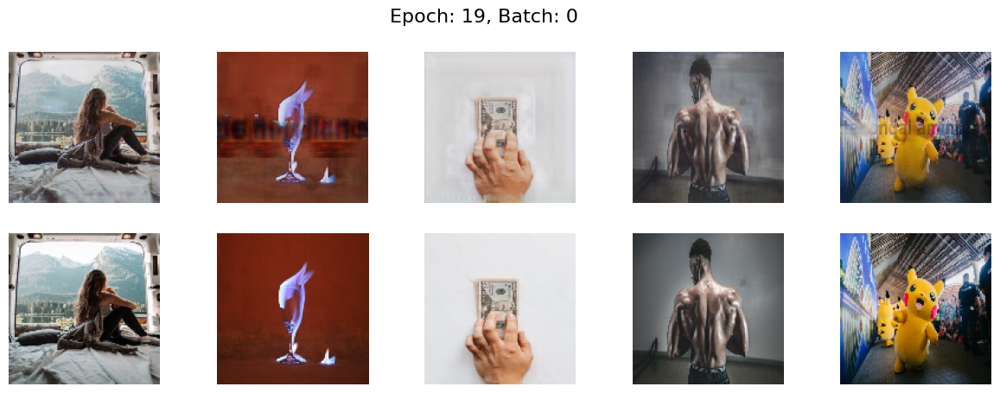

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


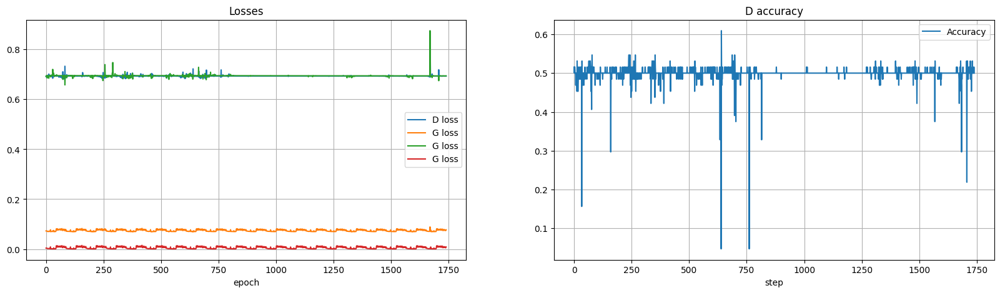

----EPOCH 20-----
0 [D loss: 0.6940,	 acc.: 46.88%]	[G loss: 0.0724]


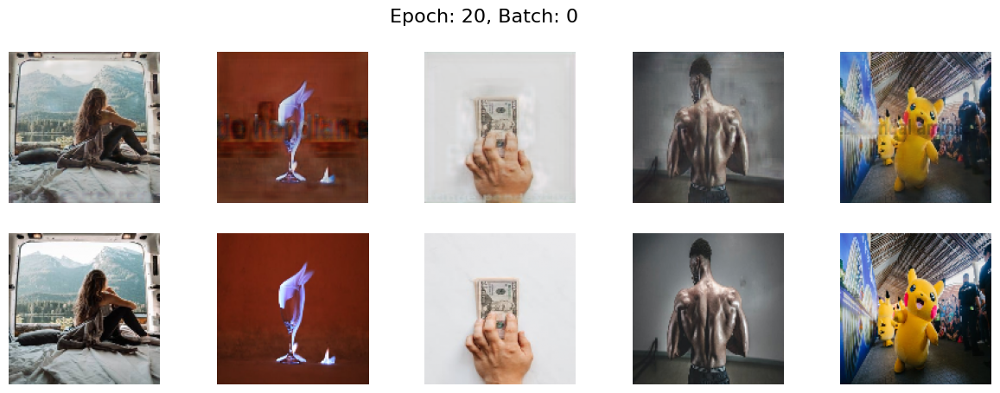

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


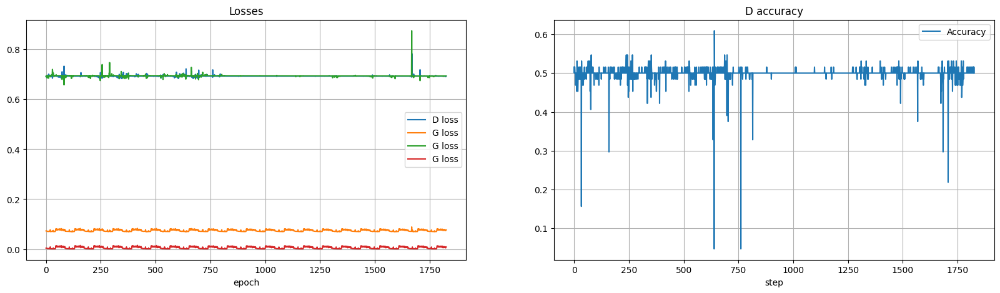

----EPOCH 21-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0728]


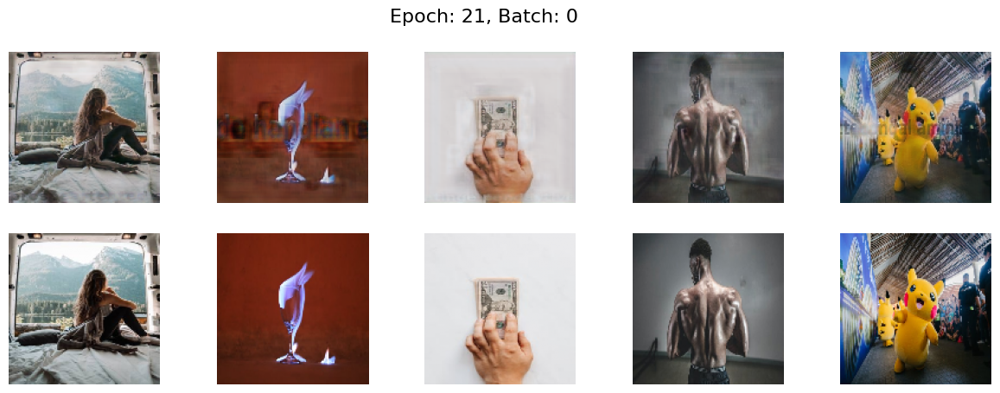

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


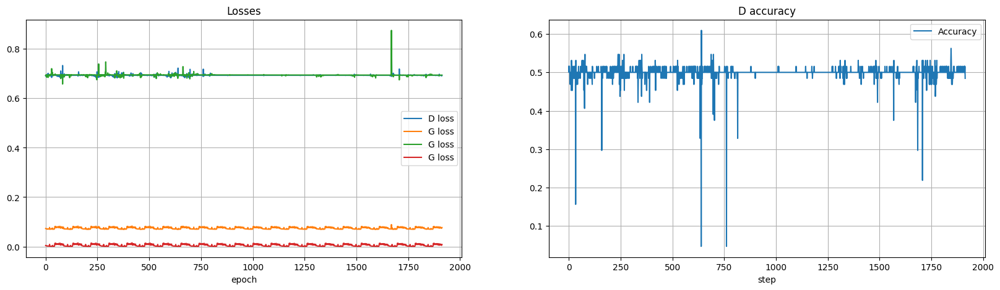

----EPOCH 22-----
0 [D loss: 0.6978,	 acc.: 35.94%]	[G loss: 0.0722]


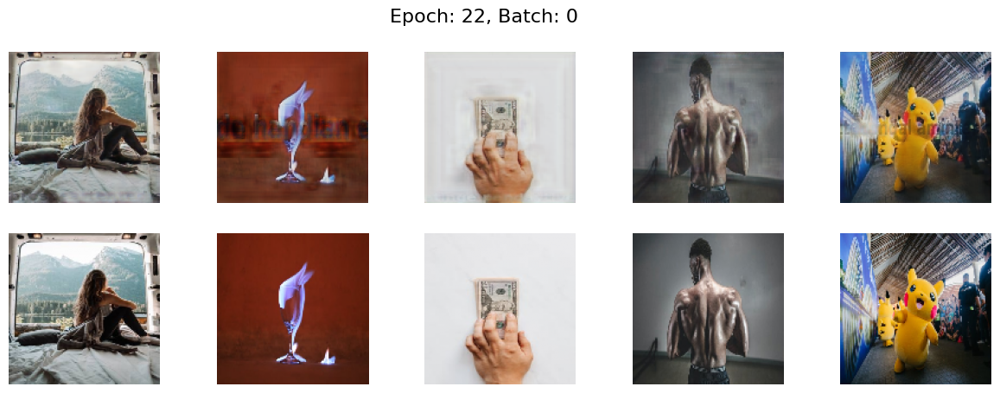

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0797]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


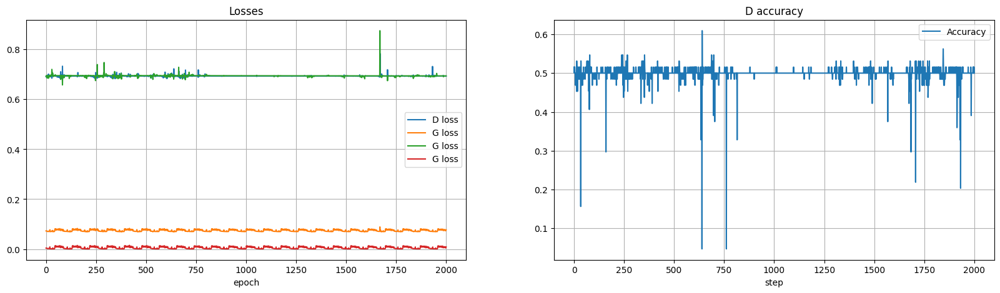

----EPOCH 23-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


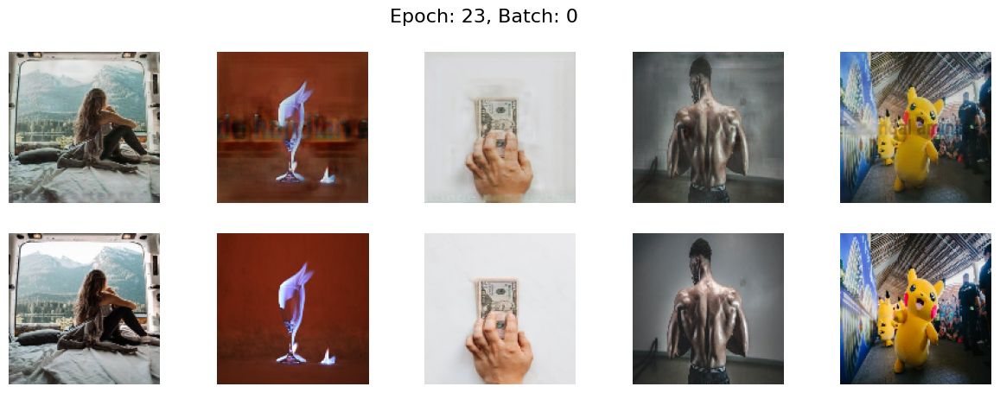

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


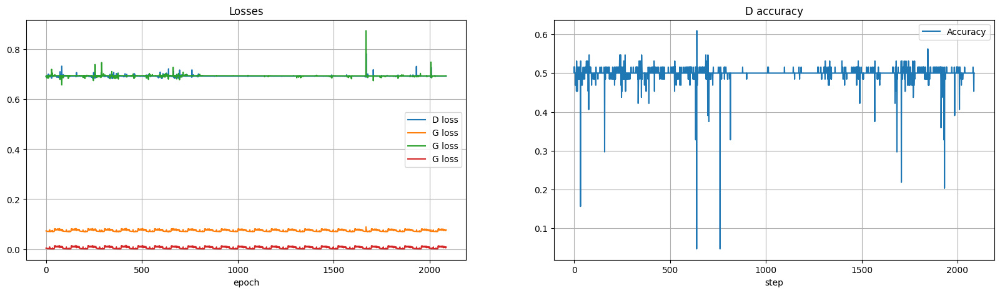

----EPOCH 24-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


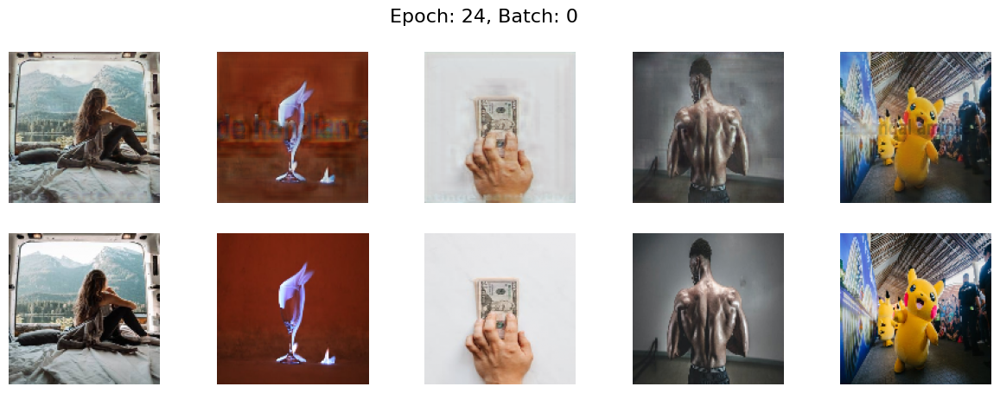

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0797]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


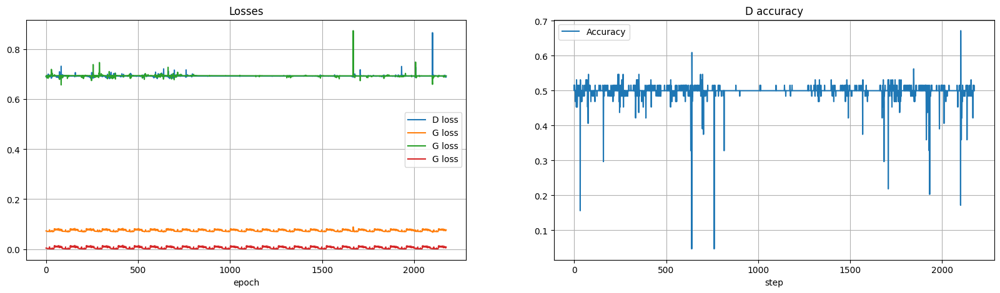

----EPOCH 25-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


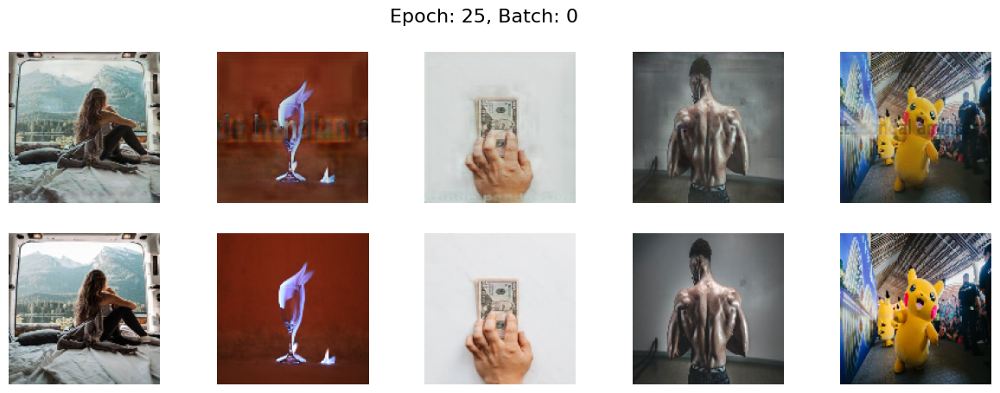

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0801]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


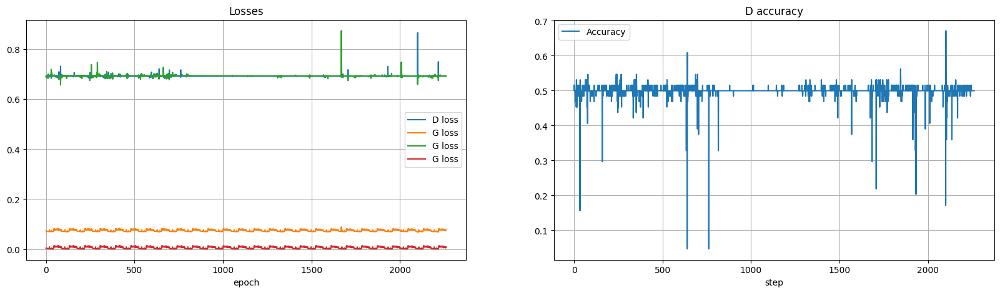

----EPOCH 26-----
0 [D loss: 0.6941,	 acc.: 48.44%]	[G loss: 0.0725]


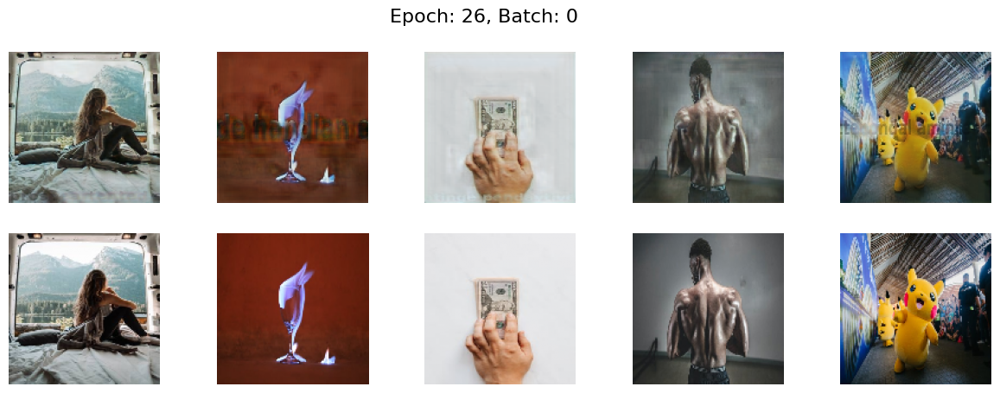

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0799]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


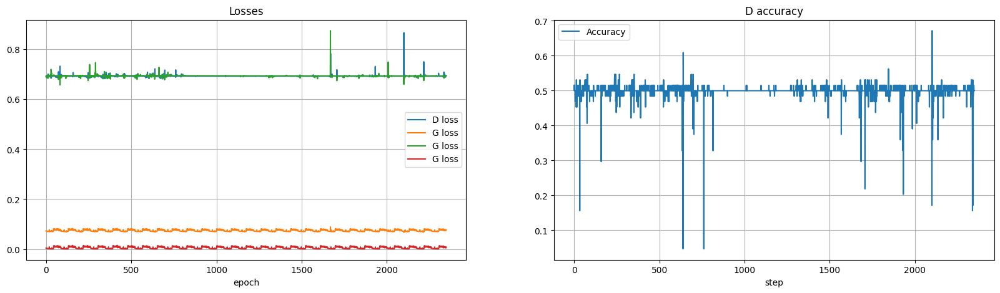

----EPOCH 27-----
0 [D loss: 0.6934,	 acc.: 42.19%]	[G loss: 0.0729]


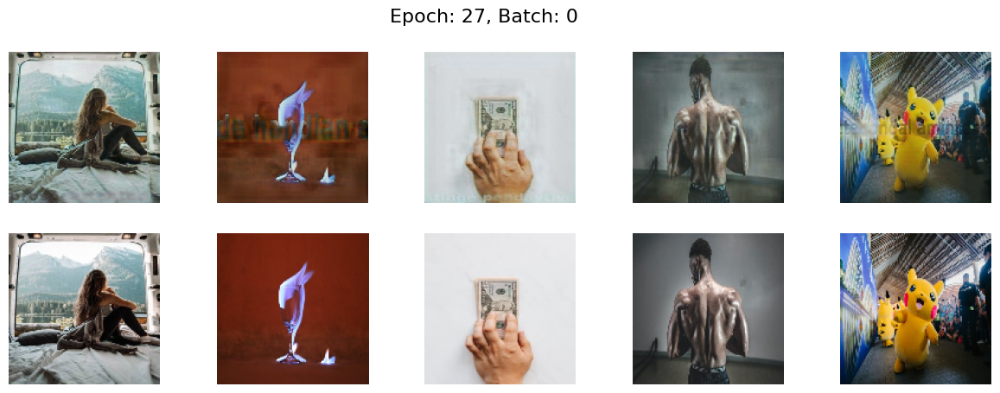

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


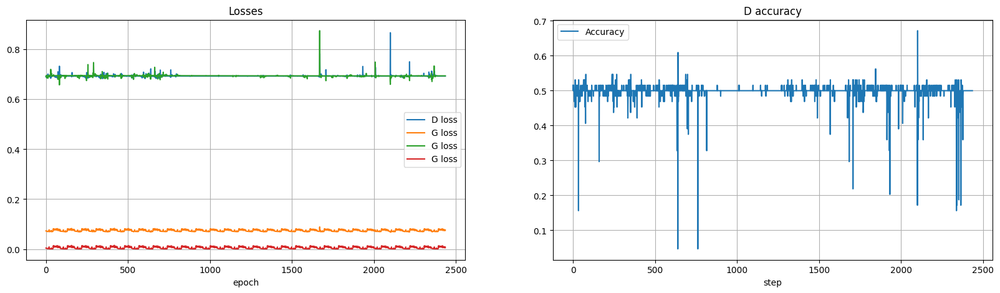

----EPOCH 28-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0725]


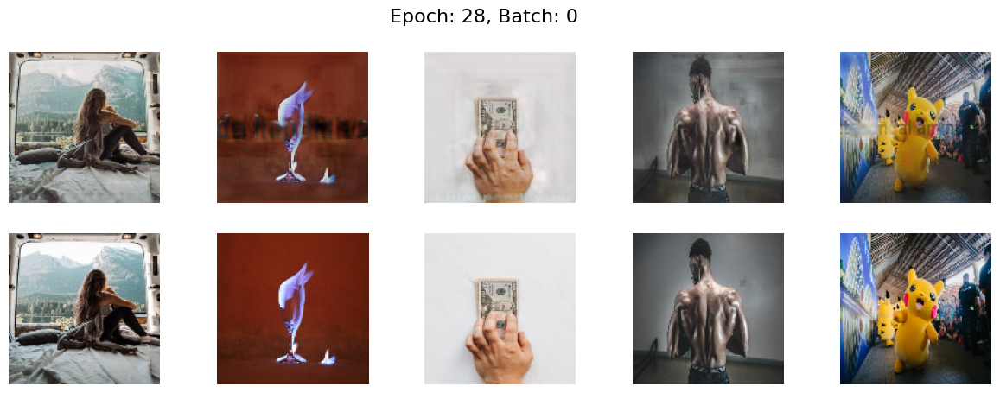

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0797]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


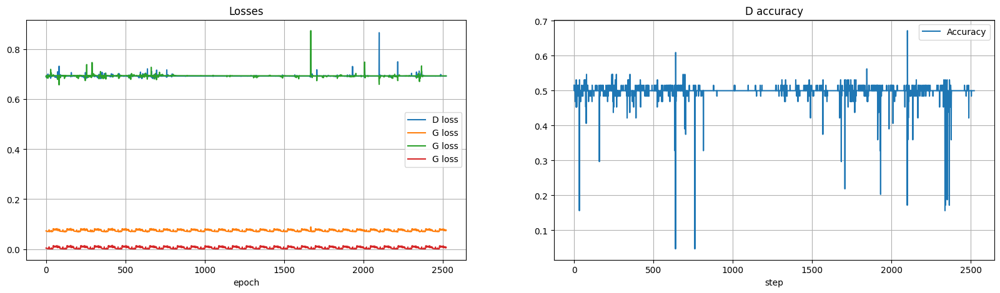

----EPOCH 29-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0723]


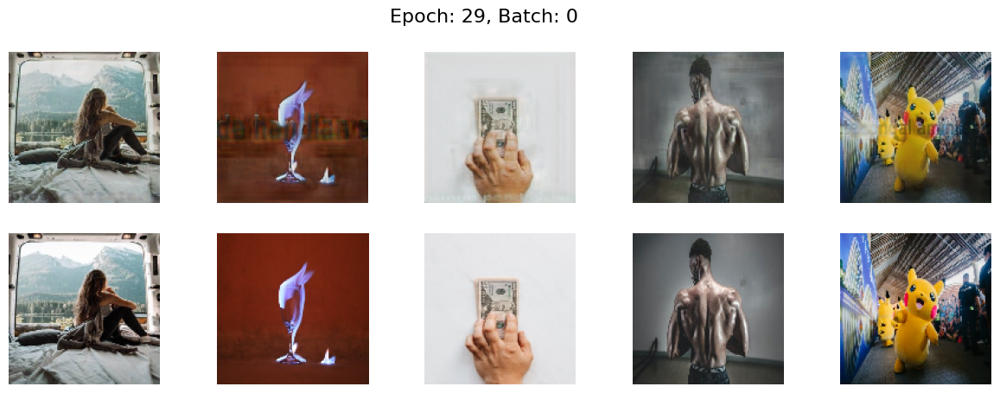

50 [D loss: 0.6932,	 acc.: 48.44%]	[G loss: 0.0796]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


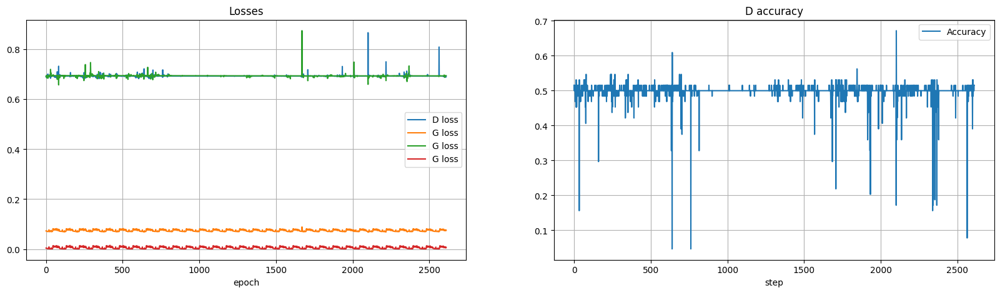

----EPOCH 30-----
0 [D loss: 0.6922,	 acc.: 51.56%]	[G loss: 0.0722]


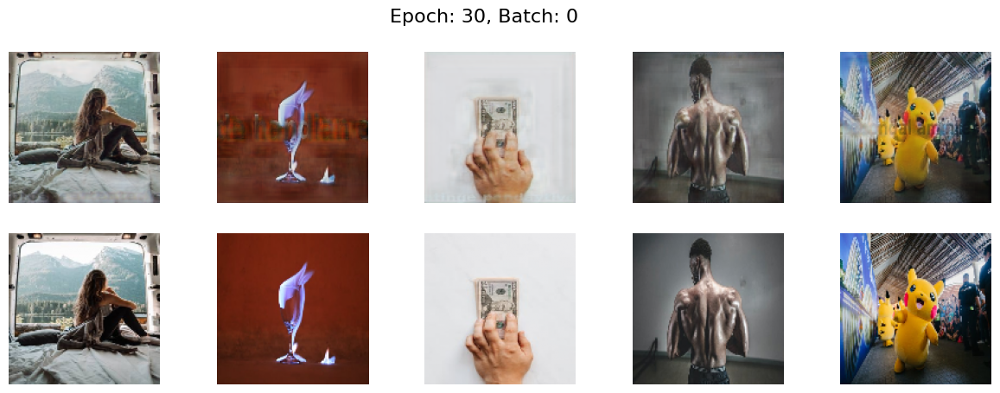

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


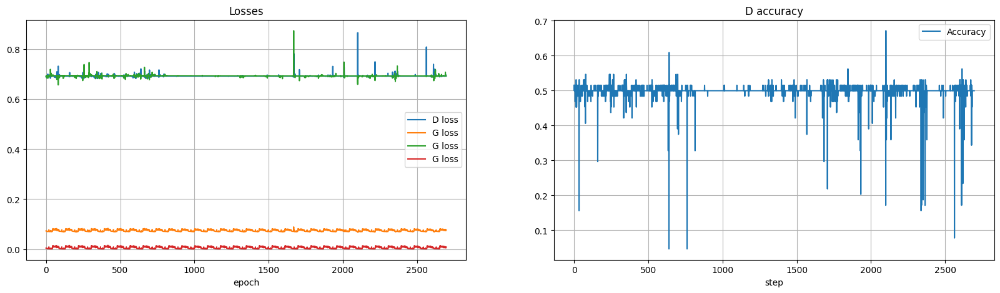

----EPOCH 31-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


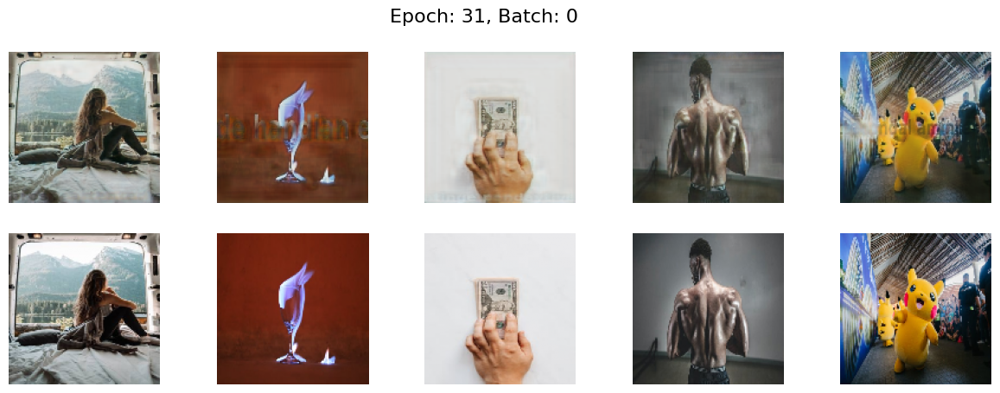

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0798]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


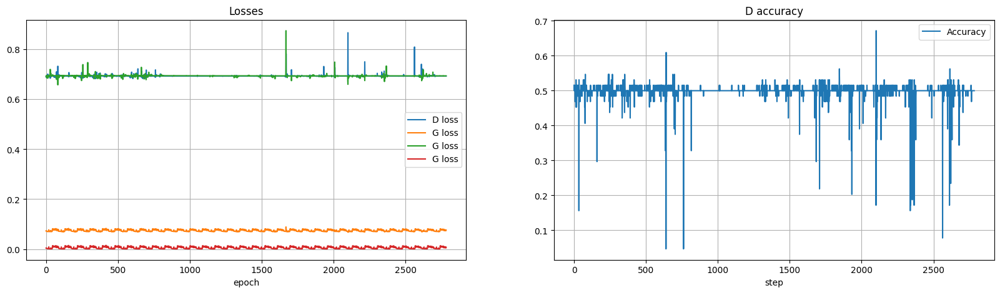

----EPOCH 32-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0728]


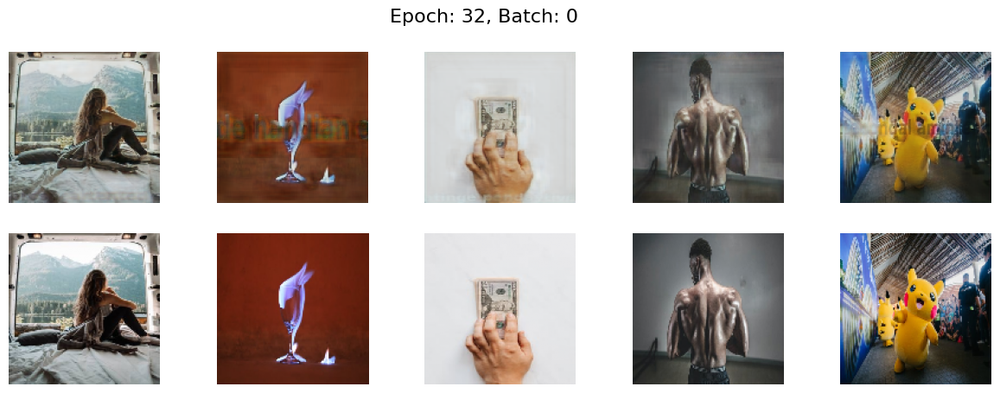

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0797]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


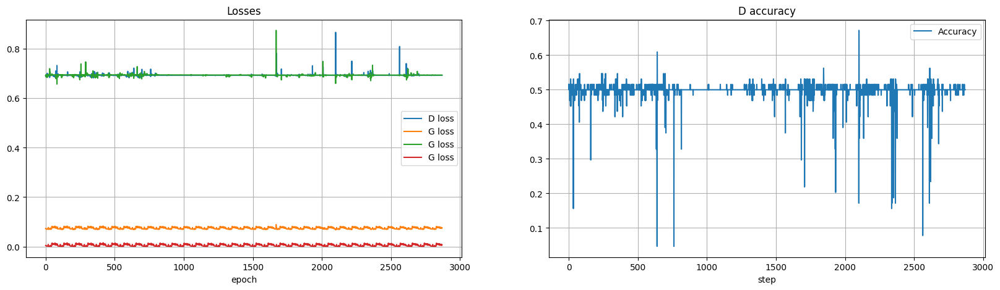

----EPOCH 33-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


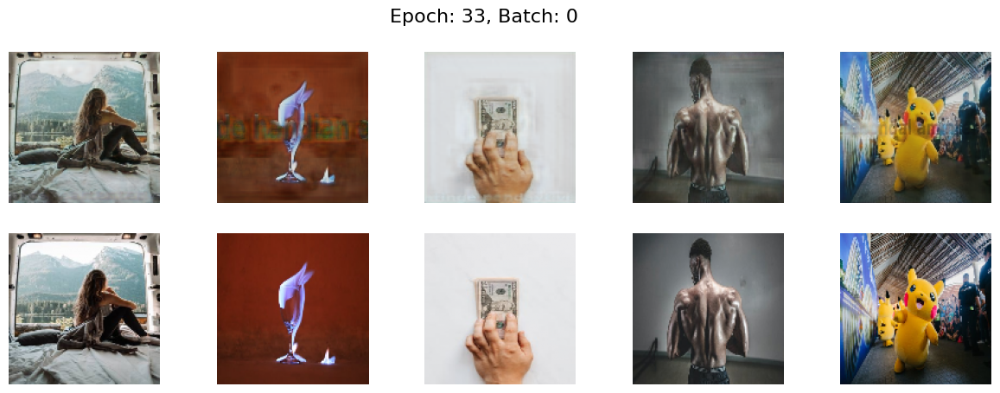

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


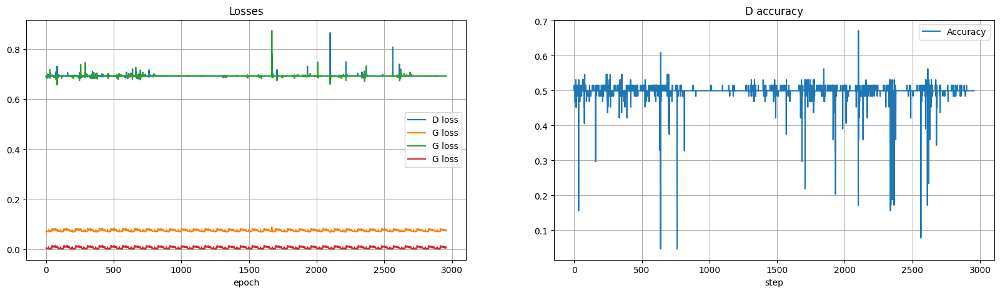

----EPOCH 34-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


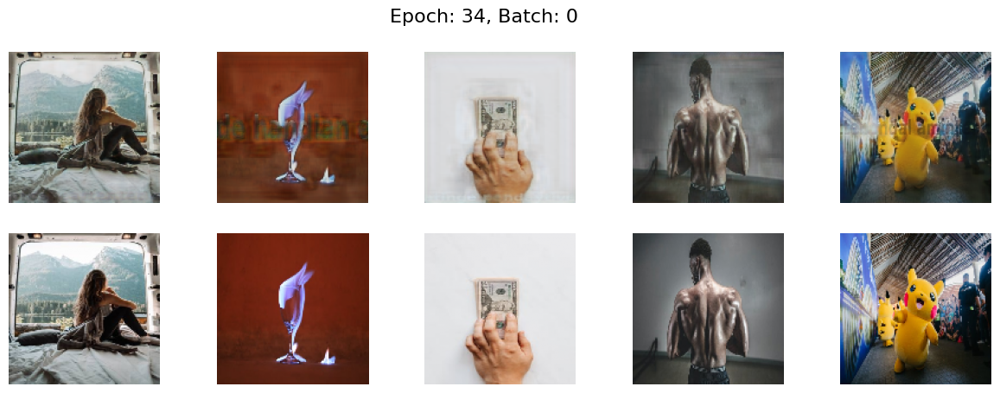

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0796]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


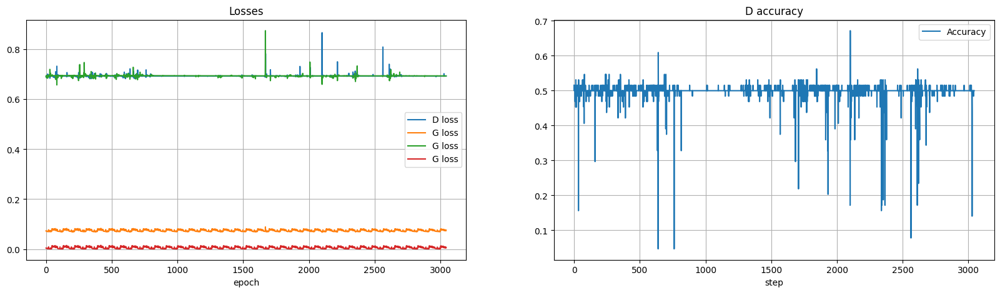

----EPOCH 35-----
0 [D loss: 0.6943,	 acc.: 48.44%]	[G loss: 0.0724]


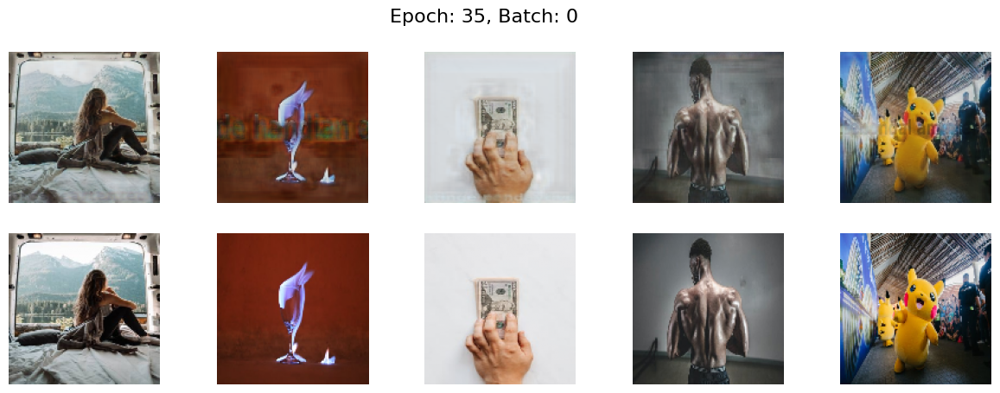

50 [D loss: 0.6931,	 acc.: 51.56%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


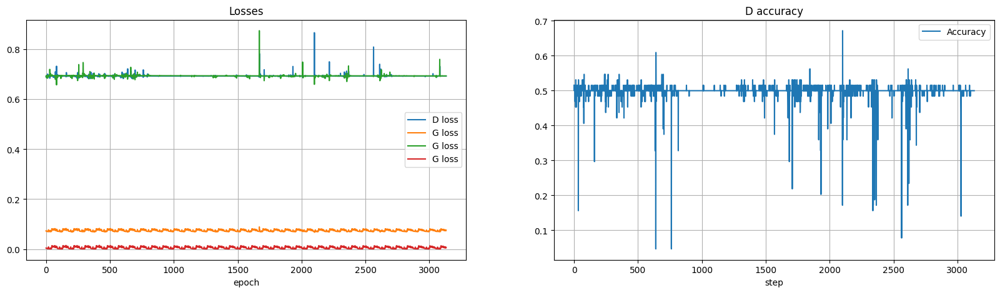

----EPOCH 36-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


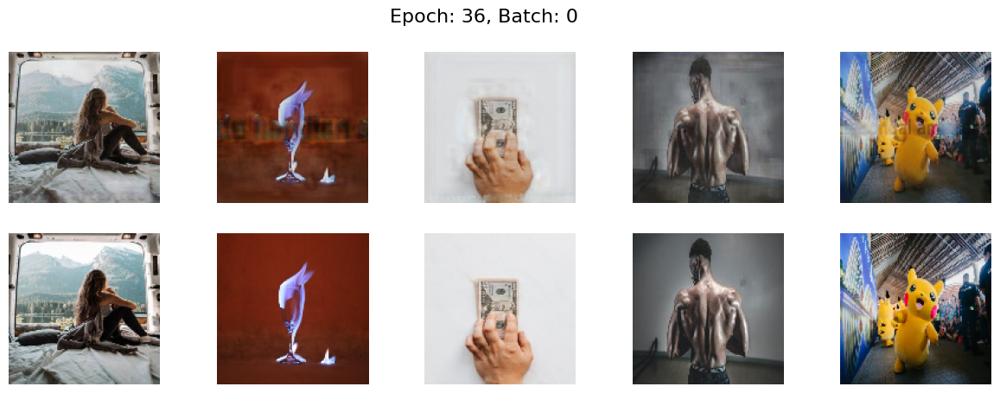

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0796]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


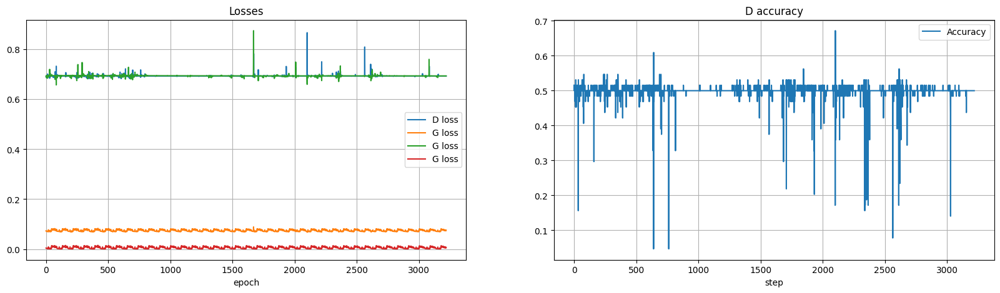

----EPOCH 37-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0725]


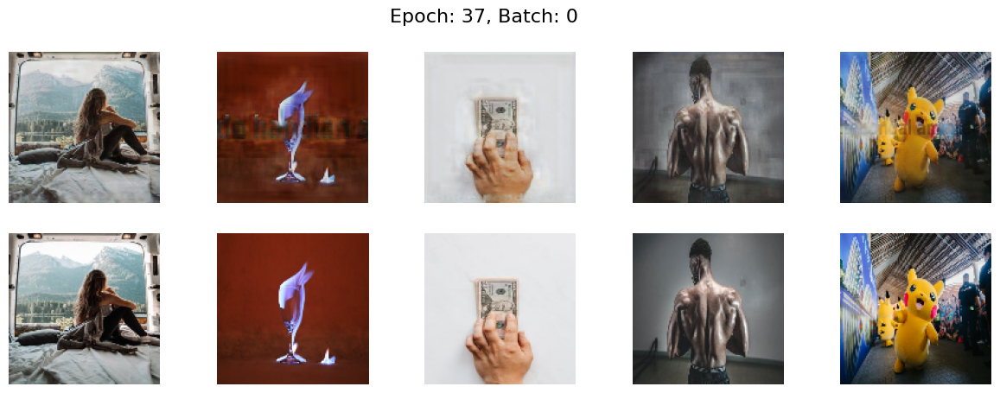

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


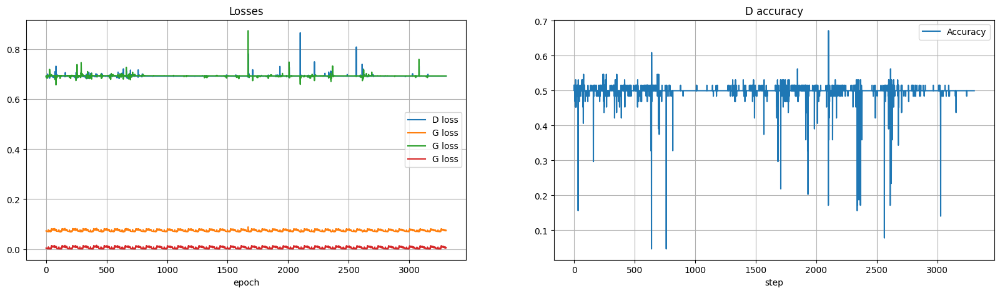

----EPOCH 38-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0723]


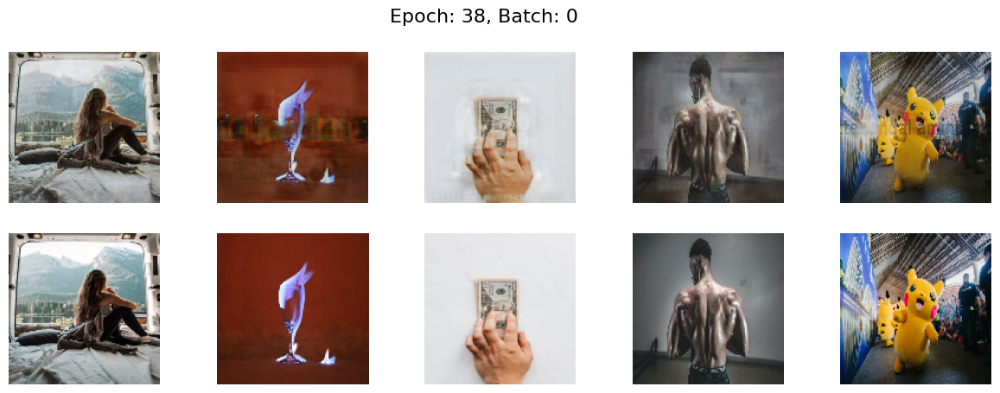

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


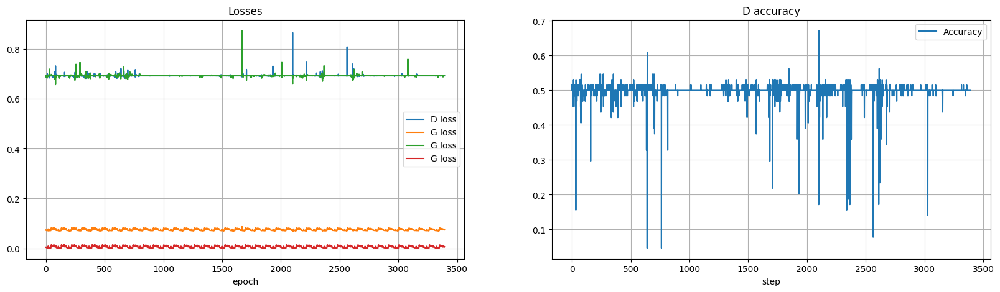

----EPOCH 39-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


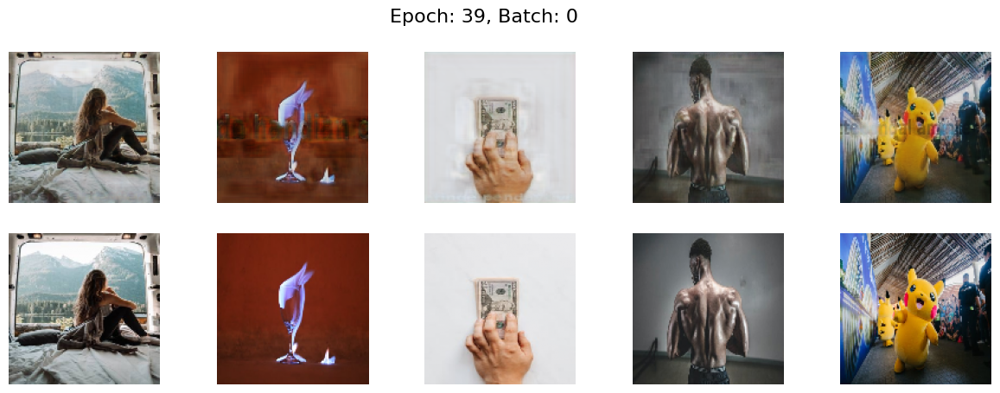

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0794]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


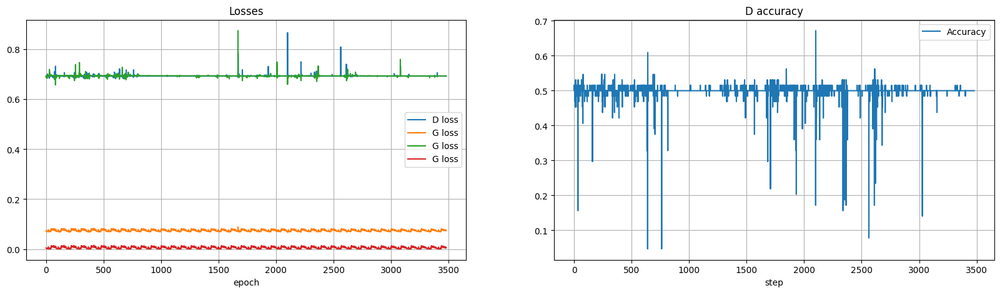

----EPOCH 40-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


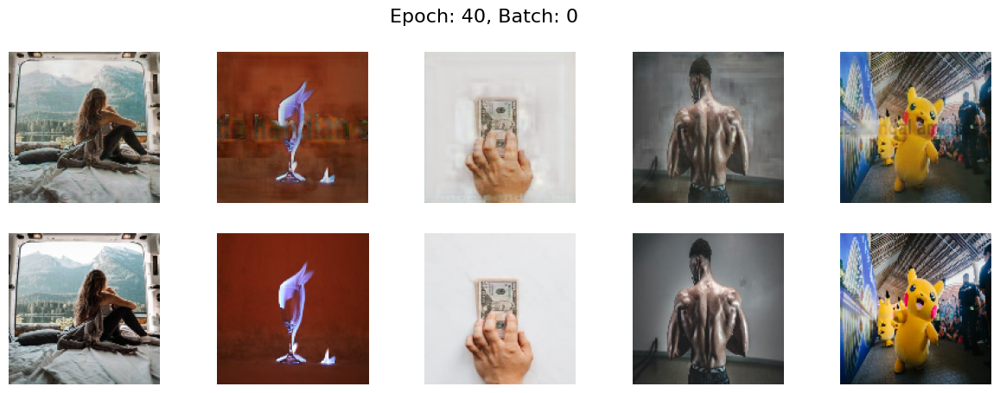

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0794]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


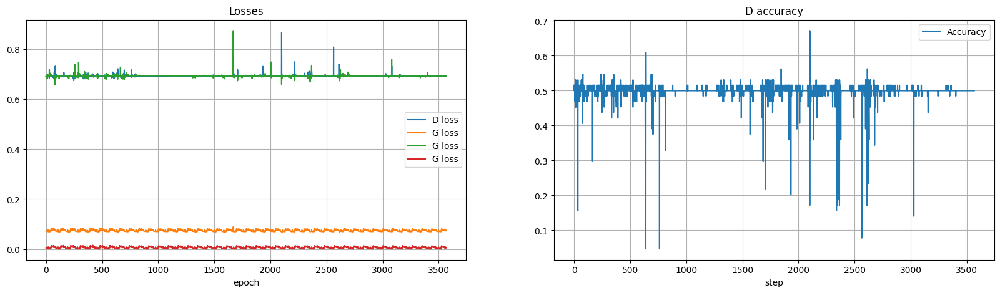

----EPOCH 41-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0728]


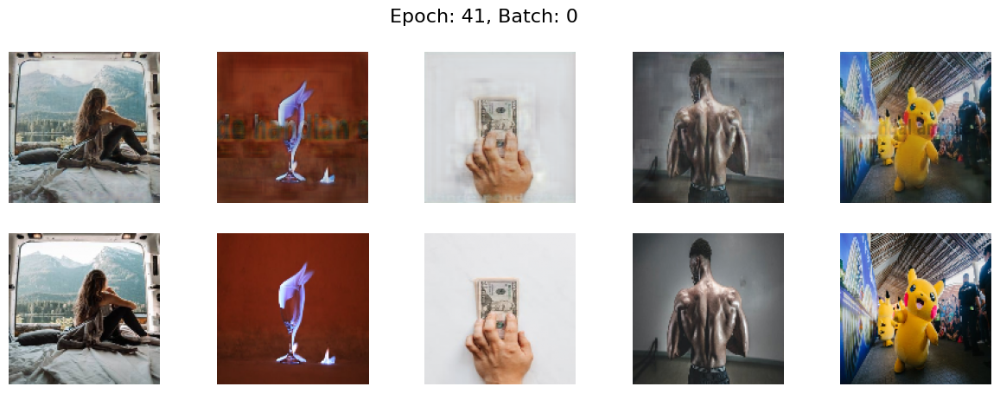

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


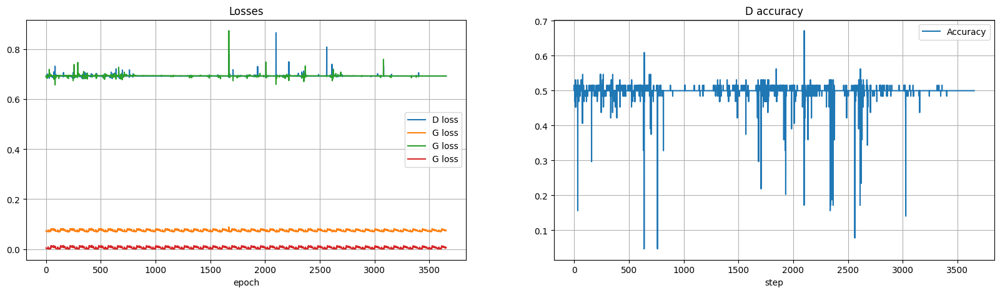

----EPOCH 42-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0727]


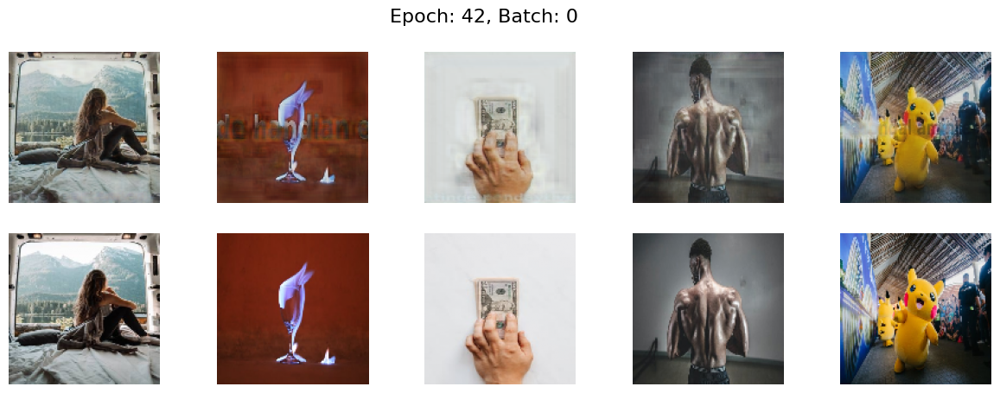

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0794]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


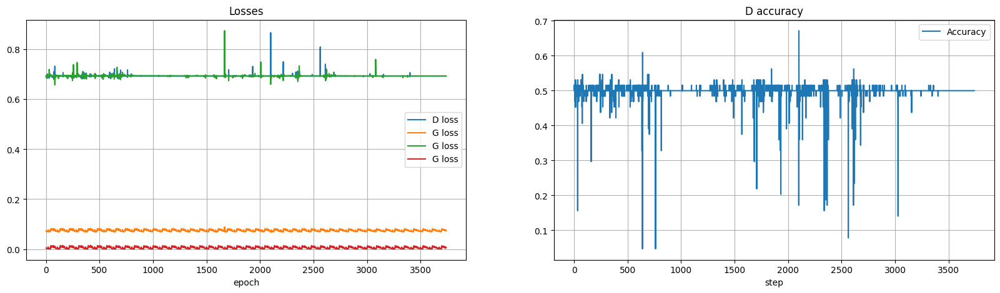

----EPOCH 43-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


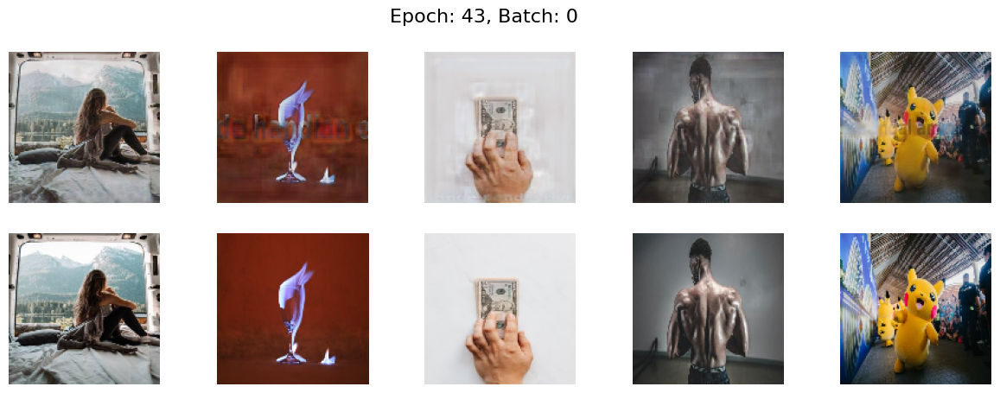

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0793]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


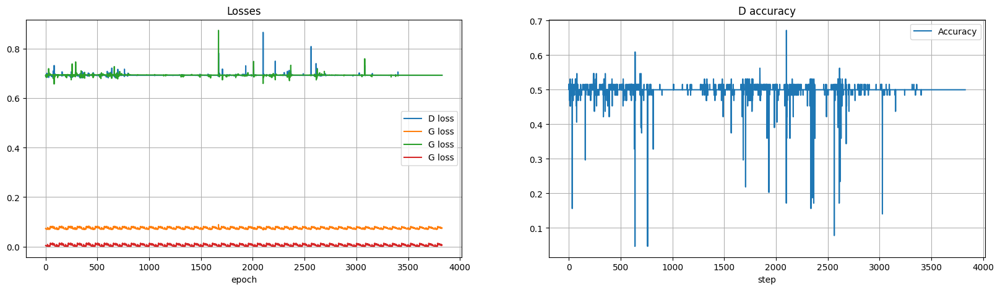

----EPOCH 44-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


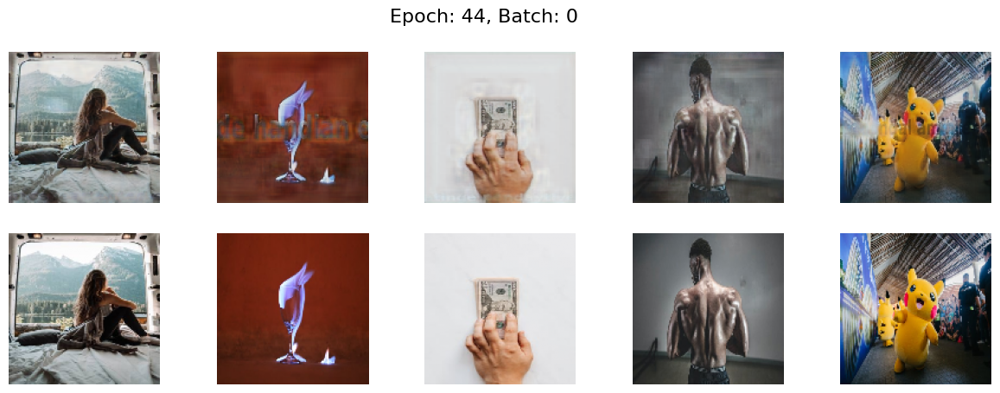

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0794]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


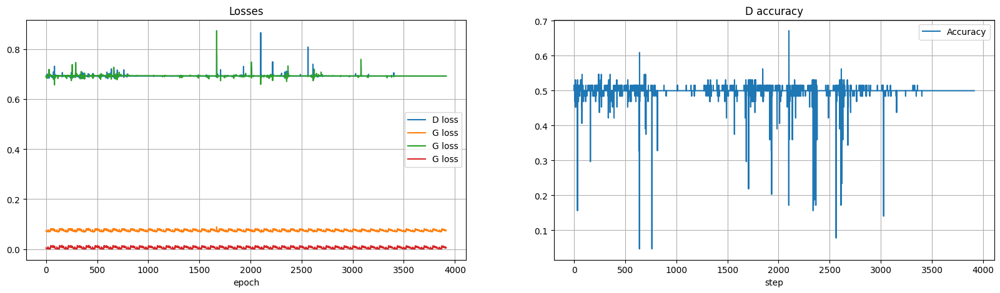

----EPOCH 45-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0725]


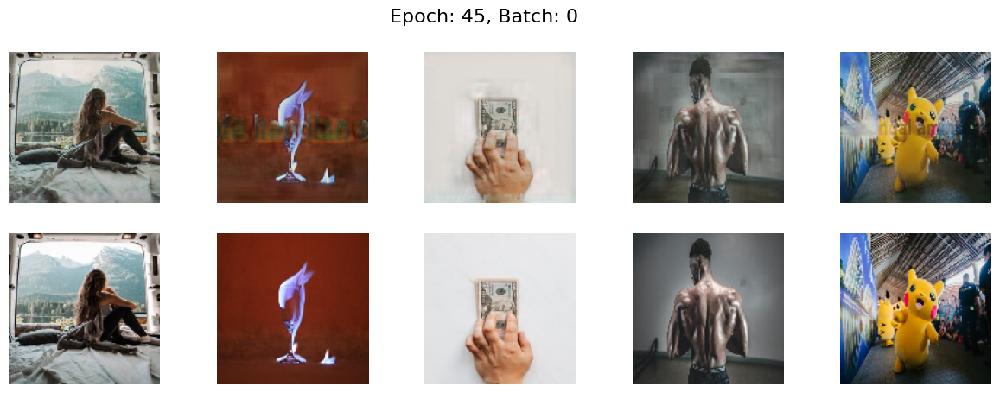

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0794]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


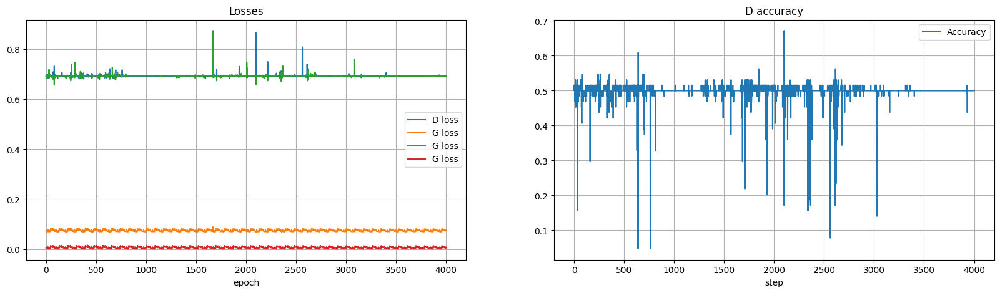

----EPOCH 46-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0726]


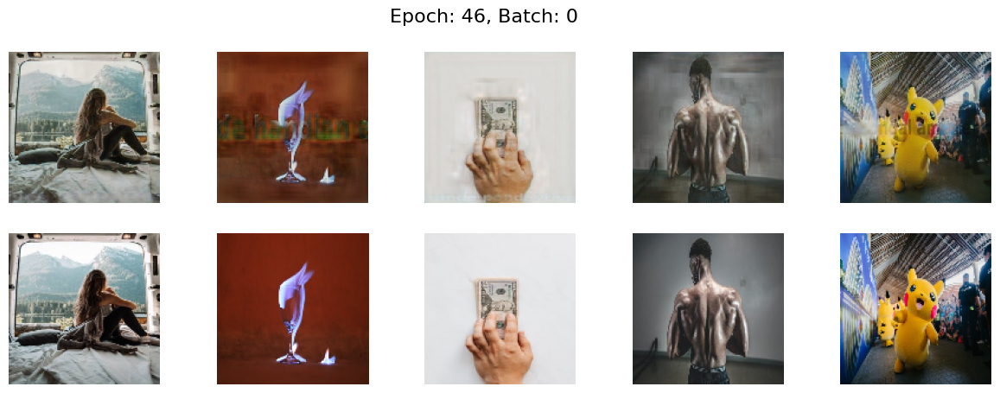

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0795]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


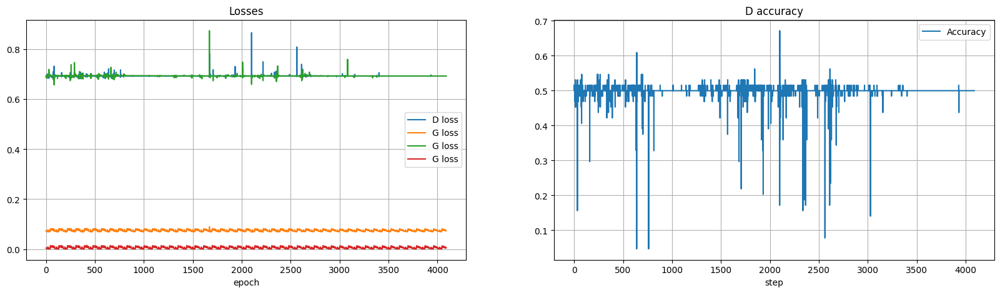

----EPOCH 47-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0723]


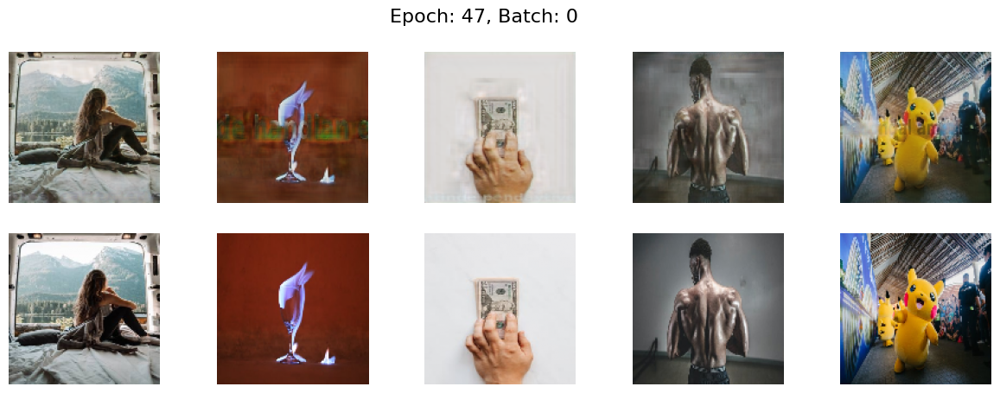

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0793]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


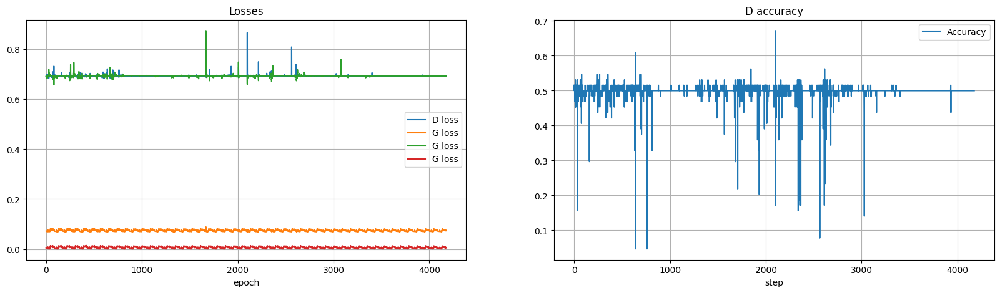

----EPOCH 48-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0724]


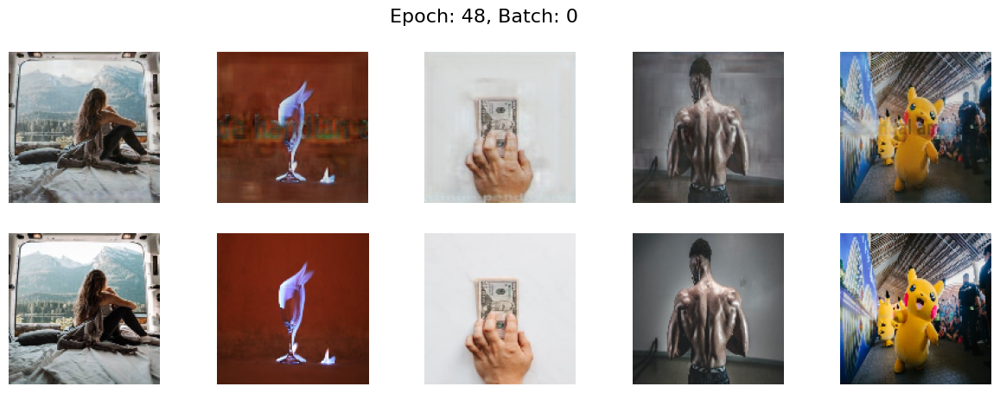

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0792]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


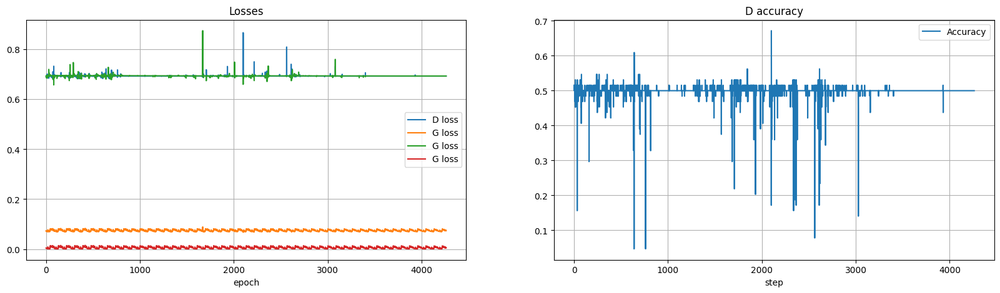

----EPOCH 49-----
0 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0721]


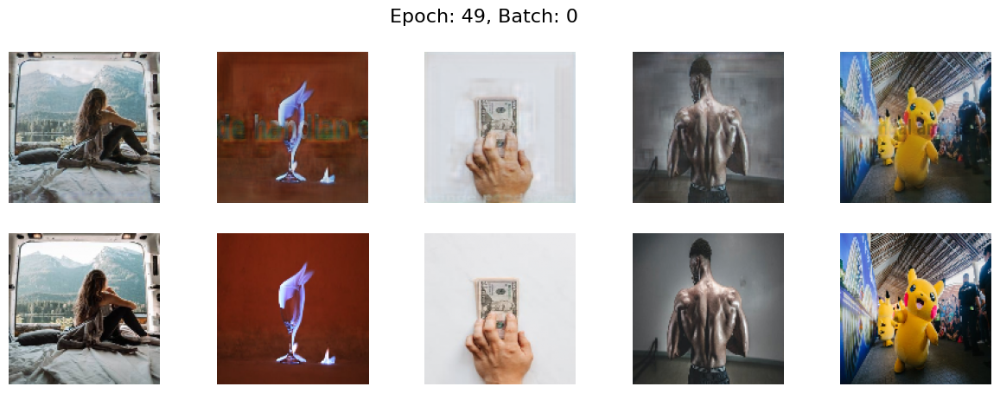

50 [D loss: 0.6932,	 acc.: 50.00%]	[G loss: 0.0792]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


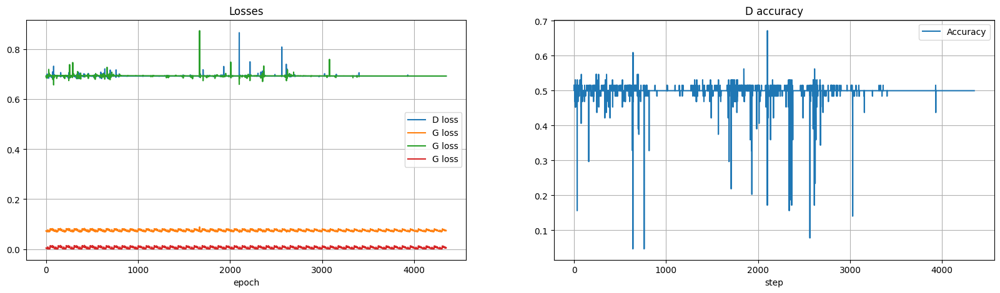

In [38]:
train(X_train, y_train, generator, discriminator, combined_model, epochs=50, batch_size=32, sample_interval=100)

#### Entrenamiento 2: Autoencoder II + Discriminador

In [ ]:
# TODO: Add model

#### Entrenamiento 3: U-Net + Discriminador

In [ ]:
# TODO: Add model

### Función de recompensa

In [8]:
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
        **config["load_and_prepare_data"]
    )

In [10]:
X_train, y_train_binary = construct_dataset(X_train, y_train)
X_val, y_val_binary = construct_dataset(X_val, y_val)
X_test, y_test_binary = construct_dataset(X_test, y_test)

In [5]:
discriminator = build_discriminator(**config["build_discriminator"])
optimizer = get_optimizer(name="adam", learning_rate=0.0008777)
discriminator.compile(
    optimizer=optimizer, loss="binary_crossentropy", metrics=["accuracy"]
)

In [6]:
# Fit the discriminator
history = discriminator.fit(
    X_train,
    y_train_binary,
    batch_size=32,
    validation_data=(X_val, y_val_binary),
    epochs=50,
)

Epoch 1/50


2023-12-17 17:48:20.079173: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-12-17 17:48:20.217079: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8902
2023-12-17 17:48:20.416790: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 17:48:20.837270: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 17:48:21.593677: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f439635e790 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-12-17 17:48:21.593712: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Cap

175/175 [==============================] - 5s 7ms/step - loss: 0.7993 - accuracy: 0.4998 - val_loss: 5.0476 - val_accuracy: 0.5047
Epoch 2/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6956 - accuracy: 0.5070 - val_loss: 1.3294 - val_accuracy: 0.5000
Epoch 3/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6959 - accuracy: 0.4918 - val_loss: 2.3564 - val_accuracy: 0.5000
Epoch 4/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6947 - accuracy: 0.4978 - val_loss: 2.7753 - val_accuracy: 0.5047
Epoch 5/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6945 - accuracy: 0.5034 - val_loss: 3.0322 - val_accuracy: 0.5047
Epoch 6/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6956 - accuracy: 0.4953 - val_loss: 6.4986 - val_accuracy: 0.5000
Epoch 7/50
175/175 [==============================] - 1s 5ms/step - loss: 0.6943 - accuracy: 0.4907 - val_loss: 6.8928 - val_accuracy: 0.5000
Epoch 8/50
175/17

In [7]:
# Evaluate the discriminator on the test set
_, test_acc = discriminator.evaluate(X_test, y_test_binary, verbose=0)
print("Test Accuracy: %.3f" % (test_acc * 100))

Test Accuracy: 75.788


In [8]:
# Save the discriminator model
discriminator.save("models/discriminator.h5")

/home/checui/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [5]:
discriminator = load_model("models/discriminator.h5")

#### Entrenamiento 4: Autoencoder I + Discriminador pre-entrenado

In [5]:
X_train, X_test, y_train, y_test, X_val, y_val = load_and_prepare_data(
        **config["load_and_prepare_data"]
    )

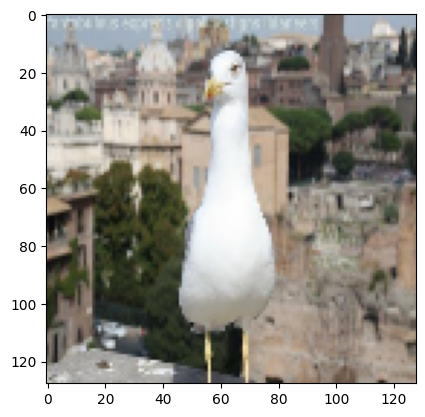

In [7]:
# Plot the first X_val image
plt.imshow(X_val[0][:, :, ::-1])

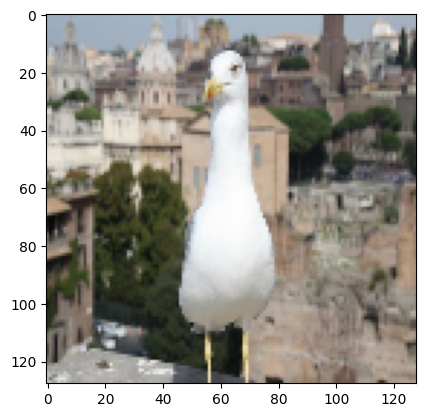

In [9]:
# Plot the first X_val image
plt.imshow(y_val[0][:, :, ::-1])

In [10]:
generator = load_model(UNET_SSC_SIN2SIN)

# Make the discriminator non-trainable when we are using it in the combined model
discriminator.trainable = False

# Build the combined model
combined = build_combined(generator, discriminator, loss_weights=[0., 1])

# 1 samples correspond to images without watermark
target = np.ones((y_train.shape[0], 1))
val_target = np.zeros((y_val.shape[0], 1))
# Fit the model
history = combined.fit(
    X_train,
    [target, y_train],
    epochs=5,
    batch_size=32,
    validation_data=(X_val, [val_target, y_val]),
)

Epoch 1/5
88/88 [==============================] - 4s 34ms/step - loss: 0.0387 - model_loss: 0.0000e+00 - model_1_loss: 0.0387 - val_loss: 18467.5879 - val_model_loss: 0.0000e+00 - val_model_1_loss: 18467.5879
Epoch 2/5
88/88 [==============================] - 3s 32ms/step - loss: 0.0181 - model_loss: 0.0000e+00 - model_1_loss: 0.0181 - val_loss: 18468.5859 - val_model_loss: 0.0000e+00 - val_model_1_loss: 18468.5859
Epoch 3/5
88/88 [==============================] - 3s 31ms/step - loss: 0.0176 - model_loss: 0.0000e+00 - model_1_loss: 0.0176 - val_loss: 18469.4492 - val_model_loss: 0.0000e+00 - val_model_1_loss: 18469.4492
Epoch 4/5
88/88 [==============================] - 3s 31ms/step - loss: 0.0166 - model_loss: 0.0000e+00 - model_1_loss: 0.0166 - val_loss: 18468.8027 - val_model_loss: 0.0000e+00 - val_model_1_loss: 18468.8027
Epoch 5/5
88/88 [==============================] - 3s 31ms/step - loss: 0.0166 - model_loss: 0.0000e+00 - model_1_loss: 0.0166 - val_loss: 18467.6855 - val_mode

In [16]:
# Predict on the test set
generator = load_model(UNET_SSC_SIN2SIN)

# Train the generator with mse loss
generator.compile(optimizer="adam", loss="mse", metrics=["mae"])

# Fit the model
history = generator.fit(
    y_train,
    X_train,
    epochs=10,
    batch_size=128,
    validation_data=(y_val, X_val),
)

Epoch 1/10


2023-12-17 18:24:06.230812: W tensorflow/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.31GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.


22/22 [==============================] - 13s 314ms/step - loss: 0.0145 - mae: 0.0893 - val_loss: 18582.2695 - val_mae: 113.3578
Epoch 2/10
22/22 [==============================] - 3s 122ms/step - loss: 0.0095 - mae: 0.0716 - val_loss: 18582.8184 - val_mae: 113.3704
Epoch 3/10
22/22 [==============================] - 3s 123ms/step - loss: 0.0087 - mae: 0.0674 - val_loss: 18582.2461 - val_mae: 113.3571
Epoch 4/10
22/22 [==============================] - 3s 125ms/step - loss: 0.0085 - mae: 0.0664 - val_loss: 18582.3438 - val_mae: 113.3599
Epoch 5/10
22/22 [==============================] - 3s 123ms/step - loss: 0.0086 - mae: 0.0674 - val_loss: 18582.6270 - val_mae: 113.3665
Epoch 6/10
22/22 [==============================] - 3s 123ms/step - loss: 0.0081 - mae: 0.0639 - val_loss: 18583.1641 - val_mae: 113.3779
Epoch 7/10
22/22 [==============================] - 3s 123ms/step - loss: 0.0082 - mae: 0.0648 - val_loss: 18583.1582 - val_mae: 113.3753
Epoch 8/10
22/22 [==========================

11/11 [==============================] - 0s 42ms/step


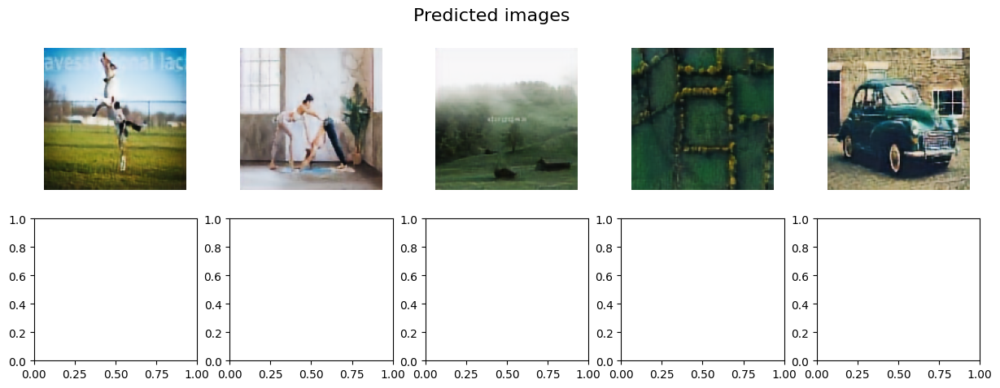

In [18]:
y_pred = generator.predict(X_test)

# Plt the first 5 images
plt.rcParams["figure.figsize"] = [15, 5]
fig, axs = plt.subplots(2, 5)
fig.suptitle("Predicted images", fontsize=16)
for i in range(5):
    axs[0, i].imshow(y_pred[i][:, :, ::-1])
    axs[0, i].axis("off")

#### Entrenamiento 5: Autoencoder II + Discriminador pre-entrenado

In [ ]:
generator = load_model(UNET_SSC_CON2CON)

# Make the discriminator non-trainable when we are using it in the combined model
discriminator.trainable = False

# Build the combined model
combined = build_combined(generator, discriminator)

# 1 samples correspond to images without watermark
target = np.ones((y_train.shape[0], 1))
val_target = np.ones((y_val.shape[0], 1))
# Fit the model
history = combined.fit(
    X_train,
    [target, y_train],
    epochs=50,
    batch_size=32,
    validation_data=(X_val, [val_target, X_val]),
)

#### Entrenamiento 6: U-Net + Discriminador pre-entrenado

In [ ]:
# TODO: Add model